# Installations

In [ ]:
# !pip install soundfile
# !pip install torchaudio

In [ ]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


# Parameters


In [ ]:
working_sr = 16000

In [ ]:
import os
import soundfile as sf
import librosa
import numpy as np
import IPython.display as ipd
import torchaudio
import torch
import torch.nn as nn
from tqdm import tqdm

In [ ]:
# original_songs_sr = 44100
# resampler = torchaudio.transforms.Resample(orig_freq=original_songs_sr, new_freq=working_sr)

# Load Data

In [ ]:
base_path = '/content/drive/MyDrive/Ofir/SoundProcessingFinalProject'
data_path = os.path.join(base_path, 'Data')
dataset_path = os.path.join(data_path, 'dataset_organized')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Load Audio Songs- no need, processed saved in drive

In [ ]:
# songs_path = os.path.join(data_path, 'songs')
# accompaniment_path = os.path.join(data_path, 'songs/accompaniment')
# vocal_path = os.path.join(data_path, 'songs/vocal')

In [ ]:
# songs_pairs = []
# for filename in os.listdir(accompaniment_path):
#     if filename.endswith(".wav"):
#         accompaniment_file = os.path.join(accompaniment_path, filename)
#         vocal_file = os.path.join(vocal_path, filename)

#         if os.path.exists(vocal_file):
#             try:
#                 # Load accompaniment and vocal files with torchaudio
#                 y_acc, sr_acc = torchaudio.load(accompaniment_file)  # [channels, samples]
#                 y_voc, sr_voc = torchaudio.load(vocal_file)

#                 # Check if sample rates are the same
#                 if sr_acc != sr_voc:
#                     print(f"Skipping {filename}: Different sample rates.")
#                     continue
#                 print(f"Sample Rate: {sr_acc}")

#                 # Ensure mono (convert stereo to mono if necessary)
#                 if y_acc.shape[0] > 1:
#                     y_acc = torch.mean(y_acc, dim=0, keepdim=True)
#                 if y_voc.shape[0] > 1:
#                     y_voc = torch.mean(y_voc, dim=0, keepdim=True)

#                 # Check if lengths are the same
#                 if y_acc.shape[1] != y_voc.shape[1]:
#                     print(f"Skipping {filename}: Different lengths.")
#                     continue

#                 songs_pairs.append((accompaniment_file, vocal_file))

#             except Exception as e:
#                 print(f"Error processing {filename}: {e}")

# print(f"Found {len(songs_pairs)} matching pairs.")

In [ ]:
# # Choose a pair by index (e.g., the first pair)
# index_to_play = 0  #@param {type:"integer"}

# if 0 <= index_to_play < len(songs_pairs):
#     accompaniment_file, vocal_file = songs_pairs[index_to_play]

#     print(f"Playing accompaniment: {accompaniment_file}")
#     ipd.display(ipd.Audio(accompaniment_file))

#     print(f"Playing vocal: {vocal_file}")
#     ipd.display(ipd.Audio(vocal_file))
# else:
#     print(f"Invalid index. Please choose an index between 0 and {len(songs_pairs) - 1}")


## Load Speech - no need, processed saved in drive

In [ ]:
# libri_speech_path = os.path.join(data_path, 'speech/LibriSpeech')

In [ ]:
# # prompt: Load LibriSpeech as pairs (audio-file, and transcript) from drive. structure: folders that contains folders that contains text file with the transcript and audio files

# libri_speech_pairs = []
# for root, _, files in os.walk(libri_speech_path):
#   #get the file that ends with .txt
#   for file in files:
#       if file.endswith(".txt"):
#         try:
#           with open(os.path.join(root, file), 'r') as f:
#             all_transcripts = f.read().strip()
#           # each row formated as '<file_name> <transcript>'
#           # example:
#           # 1272-141231-0003 HIS INSTANT OF PANIC WAS FOLLOWED BY A SMALL SHARP BLOW HIGH ON HIS CHEST while
#           # <file_name> = 1272-141231-0003 ; <transcript> = HIS INSTANT OF PANIC WAS FOLLOWED BY A SMALL SHARP BLOW HIGH ON HIS CHEST
#           # Parse all_transcripts and then Load file_name and save it as pair with its transcript (the one in the same line)
#           for line in all_transcripts.split('\n'):
#             audio_file_name, transcript = line.split(' ', 1)
#             audio_file_path = os.path.join(root, audio_file_name) + '.flac'
#             # Load the audio file
#             audio_file, sr = torchaudio.load(audio_file_path)
#             libri_speech_pairs.append((audio_file, transcript))
#         except Exception as e:
#           print(f"Error reading transcript for {line}: {e}")

# print(f"Found {len(libri_speech_pairs)} LibriSpeech pairs.")

In [ ]:
# # Example: Accessing the first pair
# if libri_speech_pairs:
#     audio_file, transcript = libri_speech_pairs[0]
#     print(f"Playing speech: {audio_file}")
#     ipd.display(ipd.Audio(audio_file, rate=sr))
#     print(f"Transcript: {transcript}")
# else:
#     print("No pairs found in libri_speech_pairs.")


# Prepare Data

In [ ]:
# spectogram parameters - currently by MelGAN
hop_length = 192
n_mels = hop_length
n_fft = hop_length * 6
sr = working_sr


## Mel Spectogram

In [ ]:
mel_transform  = torchaudio.transforms.MelSpectrogram(
    sample_rate=sr,
    n_fft=n_fft,
    win_length=n_fft,
    hop_length=hop_length,
    n_mels=n_mels,
)#.to('cuda')

def convert_waveform_to_mel_spectrogram(waveform):
    # Convert waveform to Mel spectrogram
    mel_spectrogram = mel_transform(waveform)  # Shape: [1, n_mels, time_steps]
    return mel_spectrogram

def slice_spectogram(mel_spectrogram, slice_duration):
  '''
  slice the spectogram into slices of the given duration, return list of slices
  '''
  samples_per_slice = int(sr * slice_duration / hop_length)  # Time steps per slice
  # Slice the spectrogram
  num_slices = mel_spectrogram.shape[2] // samples_per_slice
  slices = [mel_spectrogram[:, :, i * samples_per_slice:(i + 1) * samples_per_slice] for i in range(num_slices)]
  # convert slices to tensor
  slices = torch.stack(slices)

  return slices

### Data Helpers

In [ ]:
# prompt: take 2 pytorch mel spectograms batches, items in the batch are at the same length and combine items at the same index into one (like adding another audio channel- output: batch of mel spectogram at the same length that represent the original audio)

def combine_mel_spectrograms(batch1, batch2):
    """
    Combines two batches of mel spectrograms element-wise.

    Args:
        batch1: A batch of mel spectrograms (Tensor). Shape: (batch_size, n_mels, time_steps)
        batch2: A batch of mel spectrograms (Tensor). Shape: (batch_size, n_mels, time_steps)

    Returns:
        A combined batch of mel spectrograms (Tensor). Shape: (batch_size, 2, n_mels, time_steps)
    """

    # Check if input batches have the same dimensions
    if batch1.shape != batch2.shape:
        raise ValueError("Input batches must have the same dimensions.")

    # Combine the batches items
    combined_batch = batch1 + batch2
    return combined_batch


In [ ]:
# prompt: convert tensor mel-spectogram back to audio

import torch
import torchaudio

def convert_mel_to_audio(mel_spectrogram):
    """Converts a mel spectrogram back to an audio waveform.

    Args:
        mel_spectrogram: The mel spectrogram (torch.Tensor).

    Returns:
        The reconstructed audio waveform (torch.Tensor).
    """

    # Create an inverse mel spectrogram transform
    inverse_mel_transform = torchaudio.transforms.InverseMelScale(
        n_stft=n_fft // 2 + 1, n_mels=n_mels, sample_rate=sr
    )

    # Apply the inverse mel scale transform
    spectrogram = inverse_mel_transform(mel_spectrogram)

    # Create Griffin-Lim transform
    griffin_lim = torchaudio.transforms.GriffinLim(
        n_fft=n_fft, hop_length=hop_length
    )

    # Apply Griffin-Lim to reconstruct the waveform
    waveform = griffin_lim(spectrogram)
    return waveform


In [ ]:
def spectral_convergence(input, target):
    return 20 * ((input - target).norm().log10() - target.norm().log10())

def GRAD(spec, transform_fn, samples=None, init_x0=None, maxiter=1000, tol=1e-6, verbose=1, evaiter=10, lr=0.003):
    spec = torch.Tensor(spec)
    samples = (spec.shape[-1]*hop_length)-hop_length

    if init_x0 is None:
        init_x0 = spec.new_empty((1,samples)).normal_(std=1e-6)
    x = nn.Parameter(init_x0)
    T = spec

    criterion = nn.L1Loss()
    optimizer = torch.optim.Adam([x], lr=lr)

    bar_dict = {}
    metric_func = spectral_convergence
    bar_dict['spectral_convergence'] = 0
    metric = 'spectral_convergence'

    init_loss = None
    with tqdm(total=maxiter, disable=not verbose) as pbar:
        for i in range(maxiter):
            optimizer.zero_grad()
            V = transform_fn(x)
            loss = criterion(V, T)
            loss.backward()
            optimizer.step()
            lr = lr*0.9999
            for param_group in optimizer.param_groups:
              param_group['lr'] = lr

            if i % evaiter == evaiter - 1:
                with torch.no_grad():
                    V = transform_fn(x)
                    bar_dict[metric] = metric_func(V, spec).item()
                    l2_loss = criterion(V, spec).item()
                    pbar.set_postfix(**bar_dict, loss=l2_loss)
                    pbar.update(evaiter)

    return x.detach().view(-1).cpu()


### Convert Data- example- relay on the commented load data cells

In [ ]:
# # prompt: take songs pairs, convert to mel spectogram using the helpers functions above and convert back to audio and play it

# # Choose a pair by index
# index_to_play = 0  #@param {type:"integer"}

# if 0 <= index_to_play < len(songs_pairs):
#     accompaniment_file, vocal_file = songs_pairs[index_to_play]

#     # Load the accompaniment and vocal files
#     # y_acc, sr_acc = torchaudio.load(accompaniment_file)
#     y_voc, sr_voc = torchaudio.load(vocal_file)
#     y_voc = resampler(y_voc)
#     # Convert to mel spectrograms
#     # mel_acc = convert_waveform_to_mel_spectrogram(y_acc)
#     mel_voc = convert_waveform_to_mel_spectrogram(y_voc)
#     sliced = slice_spectogram(mel_voc, 10)[1]
#     # Combine the spectrograms (example: simple addition)
#     # combined_mel = combine_mel_spectrograms(mel_acc, mel_voc)

#     # Convert the combined spectrogram back to audio
#     reconstructed_audio = GRAD(sliced, mel_transform)

#     # Play the reconstructed audio
#     print("Playing reconstructed audio:")
#     ipd.display(ipd.Audio(reconstructed_audio.numpy(), rate=sr))
# else:
#     print(f"Invalid index. Please choose an index between 0 and {len(songs_pairs) - 1}")


# Model

In [ ]:
conv_dim = n_mels
d_conv_dim = 2 * conv_dim
k_common_size = 100
spec_norm = lambda x:  torch.nn.utils.spectral_norm(x) #Spectral normalization is a technique used to stabilize the training of GANs by controlling the Lipschitz constant of the layers.


## Generators

In [ ]:
# gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal, optimizers = get_networks()
# fake_vocs = gen_speech2sing(mel_speeches, mel_accs)

Built networks


In [ ]:
# Convolutional layers extract features from the input.
# Deconvolutional layers upsample the feature maps to generate the output.
class generator_speech2sing(nn.Module):
    def __init__(self):
        super(generator_speech2sing,self).__init__()
        # Acc Prep
        self.conv1_acc = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(1, 256, kernel_size = (192, 3), stride=1,padding=(0,0))),
                    nn.BatchNorm2d(256),
                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2_acc = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3_acc = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 40, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),
            nn.BatchNorm2d(40),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv4_acc = spec_norm(
            nn.ConvTranspose2d(40, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3)))
        self.deconv4_BAD_acc = nn.Sequential(
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv5_acc = spec_norm(
            nn.ConvTranspose2d(512, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4)))
        self.deconv5_BAD_acc = nn.Sequential(

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv6_acc = spec_norm(
            nn.ConvTranspose2d(512 , 1, kernel_size = (192, 1), stride=(1, 1), padding=(0,0)))
        # Regular
        self.conv1 = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(2, 256, kernel_size = (192, 27), stride=1,padding=(0,12))),
                    nn.BatchNorm2d(256),
                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2 = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3 = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv4 = spec_norm(
            nn.ConvTranspose2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3)))
        self.deconv4_BAD = nn.Sequential(
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv5 = spec_norm(
            nn.ConvTranspose2d(512, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4)))
        self.deconv5_BAD = nn.Sequential(

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv6 = spec_norm(
            nn.ConvTranspose2d(512 , 1, kernel_size = (192, 1), stride=(1, 1), padding=(0,0)))
    def forward(self,spec_speech, spec_acc):
        ############## ACC
        # print(spec_acc.shape)
        spec_pad_acc = torch.functional.F.pad(spec_acc,(1,1))
        conv1_out_acc = self.conv1_acc(spec_pad_acc)
        # print(conv1_out_acc.shape)
        conv2_out_acc = self.conv2_acc(conv1_out_acc)
        # print(conv2_out_acc.shape)
        conv3_out_acc = self.conv3_acc(conv2_out_acc)
        # print(conv3_out_acc.shape)
        deconv4_out_acc = self.deconv4_acc(conv3_out_acc , output_size = conv2_out_acc.size())
        deconv4_out_acc =  torch.cat([self.deconv4_BAD_acc(deconv4_out_acc),conv2_out_acc],1)
        # print(deconv4_out.shape)
        deconv5_out_acc = self.deconv5_acc(deconv4_out_acc , output_size = conv1_out_acc.size())
        deconv5_out_acc = torch.cat([self.deconv5_BAD_acc(deconv5_out_acc),conv1_out_acc],1)
        # print(deconv5_out.shape)
        deconv6_out_acc = torch.functional.F.tanh(self.deconv6_acc(deconv5_out_acc, output_size = spec_acc.size()))

        ##############
        # create spec- two channels of 'spec_speech, spec_acc'
        spec = torch.cat((spec_speech, deconv6_out_acc), 1)
        # print(spec.shape)
        spec_pad = torch.functional.F.pad(spec,(1,1))
        conv1_out = self.conv1(spec_pad)
        # print(conv1_out.shape)
        conv2_out = self.conv2(conv1_out)
        # print(conv2_out.shape)
        conv3_out = self.conv3(conv2_out)
        # print(conv3_out.shape)
        deconv4_out = self.deconv4(conv3_out , output_size = conv2_out.size())
        deconv4_out =  torch.cat([self.deconv4_BAD(deconv4_out),conv2_out],1)
        # print(deconv4_out.shape)
        deconv5_out = self.deconv5(deconv4_out , output_size = conv1_out.size())
        deconv5_out = torch.cat([self.deconv5_BAD(deconv5_out),conv1_out],1)
        # print(deconv5_out.shape)
        deconv6_out = torch.functional.F.tanh(self.deconv6(deconv5_out, output_size = spec.size()))
        return deconv6_out

In [ ]:
# Convolutional layers extract features from the input.
# Deconvolutional layers upsample the feature maps to generate the output.

class generator_sing2speech(nn.Module):
    def __init__(self):
        super(generator_sing2speech,self).__init__()
        self.conv1 = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(1, 256, kernel_size = (192, 3), stride=1,padding=(0,0))),
                    nn.BatchNorm2d(256),
                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2 = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3 = nn.Sequential(
            spec_norm(
            nn.Conv2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv4 = spec_norm(
            nn.ConvTranspose2d(256, 256, kernel_size = (1, 7), stride=(1, 2), padding=(0,3)))
        self.deconv4_BAD = nn.Sequential(
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv5 = spec_norm(
            nn.ConvTranspose2d(512, 256, kernel_size = (1, 9), stride=(1, 2), padding=(0,4)))
        self.deconv5_BAD = nn.Sequential(

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.deconv6 = spec_norm(
            nn.ConvTranspose2d(512 , 1, kernel_size = (192, 1), stride=(1, 1), padding=(0,0)))
    def forward(self,spec):
        spec_pad = torch.functional.F.pad(spec,(1,1))
        conv1_out = self.conv1(spec_pad)
        # print(conv1_out.shape)
        conv2_out = self.conv2(conv1_out)
        # print(conv2_out.shape)
        conv3_out = self.conv3(conv2_out)
        # print(conv3_out.shape)
        deconv4_out = self.deconv4(conv3_out , output_size = conv2_out.size())
        deconv4_out =  torch.cat([self.deconv4_BAD(deconv4_out),conv2_out],1)
        # print(deconv4_out.shape)
        deconv5_out = self.deconv5(deconv4_out , output_size = conv1_out.size())
        deconv5_out = torch.cat([self.deconv5_BAD(deconv5_out),conv1_out],1)
        # print(deconv5_out.shape)
        deconv6_out = torch.functional.F.tanh(self.deconv6(deconv5_out, output_size = spec.size()))
        return deconv6_out

## Discrimenator

In [ ]:
class discriminator_vocal_accompaniment(nn.Module):
    def __init__(self):
        super(discriminator_vocal_accompaniment,self).__init__()
        self.conv1 = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(1, 512, kernel_size = (192, 3), stride=1,padding=(0,0))),

                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2 = nn.Sequential(
            spec_norm(
            nn.Conv2d(512, 512, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3 = nn.Sequential(
            spec_norm(
            nn.Conv2d(512, 512, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        # self.dense1 = nn.Sequential(nn.Linear(4352,640), nn.LeakyReLU(negative_slope=0.2,inplace=True))
        self.dense1 = torch.nn.utils.spectral_norm(nn.Linear(9216,1))
    def forward(self,spec):
        # print(spec.shape)
        conv1_out = self.conv1(spec)
        # print (conv1_out.shape)
        conv2_out = self.conv2(conv1_out)
        # print (conv2_out.shape)
        conv3_out = self.conv3(conv2_out)
        # print (conv3_out.shape)
        flatten = torch.flatten(conv3_out,start_dim=1)
        # print(flatten.shape)
        mean = torch.mean(flatten)
        # print(mean.shape)
        return mean
        # return self.dense2(d1)

In [ ]:
class discriminator_vocal(nn.Module):
    def __init__(self):
        super(discriminator_vocal,self).__init__()
        self.conv1 = nn.Sequential(
                    spec_norm(
                    nn.Conv2d(1, 512, kernel_size = (192, 3), stride=1,padding=(0,0))),

                    nn.LeakyReLU(negative_slope=0.2,inplace=True)
                )
        self.conv2 = nn.Sequential(
            spec_norm(
            nn.Conv2d(512, 512, kernel_size = (1, 9), stride=(1, 2), padding=(0,4))),

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        self.conv3 = nn.Sequential(
            spec_norm(
            nn.Conv2d(512, 512, kernel_size = (1, 7), stride=(1, 2), padding=(0,3))),

            nn.LeakyReLU(negative_slope=0.2,inplace=True)
        )
        # self.dense1 = nn.Sequential(nn.Linear(4352,640), nn.LeakyReLU(negative_slope=0.2,inplace=True))
        self.dense1 = torch.nn.utils.spectral_norm(nn.Linear(9216,1))
    def forward(self,spec):
        # print(spec.shape)
        conv1_out = self.conv1(spec)
        # print (conv1_out.shape)
        conv2_out = self.conv2(conv1_out)
        # print (conv2_out.shape)
        conv3_out = self.conv3(conv2_out)
        # print (conv3_out.shape)
        flatten = torch.flatten(conv3_out,start_dim=1)
        # print(flatten.shape)
        mean = torch.mean(flatten)
        # print(mean.shape)
        return mean
        # return self.dense2(d1)

## Losses

In [ ]:
def mae(x,y):
  return torch.functional.F.l1_loss(x,y)

def mse(x,y):
  return torch.functional.F.l2_loss(x,y)

def d_loss_f(fake):
  return torch.mean(torch.relu(1 + fake))

def d_loss_r(real):
  return torch.mean(torch.relu(1 - real))

def g_loss_f(fake):
  return torch.mean(-fake)


## Network

In [ ]:
    # Define the save path in Google Drive
save_path = os.path.join(base_path, 'saved_models', 'V2')  # Adjust the path as needed
os.makedirs(save_path, exist_ok=True)  # Create the directory if it doesn't exist
# Save models after each epoch
gen_speech2sing_save_path = os.path.join(save_path, f'gen_speech2sing_const.pth')
gen_sing2speech_save_path = os.path.join(save_path, f'gen_sing2speech_epoch_const.pth')
discrim_whole_save_path = os.path.join(save_path, f'discrim_whole_epoch_const.pth')
discrim_vocal_save_path = os.path.join(save_path, f'discrim_vocal_epoch_const.pth')

def save_models(gen_speech2sing,gen_sing2speech,discrim_whole,discrim_vocal):
  torch.save(gen_speech2sing.state_dict(), gen_speech2sing_save_path)
  torch.save(gen_sing2speech.state_dict(), gen_sing2speech_save_path)
  torch.save(discrim_whole.state_dict(), discrim_whole_save_path)
  torch.save(discrim_vocal.state_dict(), discrim_vocal_save_path)


In [ ]:
#Get models and optimizers
def get_networks():
  global generator_speech2sing, generator_sing2speech, discriminator_vocal_accompaniment, discriminator_vocal
  gen_speech2sing = generator_speech2sing()
  gen_sing2speech = generator_sing2speech()
  discrim_whole = discriminator_vocal_accompaniment()
  discrim_vocal = discriminator_vocal()

  print('Built networks')
  #Load saved dicts
  if os.path.exists(gen_speech2sing_save_path):
    gen_speech2sing.load_state_dict(torch.load(gen_speech2sing_save_path))
    print('Loaded gen_speech2sing saved parameters')
  if os.path.exists(gen_sing2speech_save_path):
    gen_sing2speech.load_state_dict(torch.load(gen_sing2speech_save_path))
    print('Loaded gen_sing2speech saved parameters')
  if os.path.exists(discrim_whole_save_path):
    discrim_whole.load_state_dict(torch.load(discrim_whole_save_path))
    print('Loaded discrim_whole saved parameters')
  if os.path.exists(discrim_vocal_save_path):
    discrim_vocal.load_state_dict(torch.load(discrim_vocal_save_path))
    print('Loaded discrim_vocal saved parameters')

  opt_gen = torch.optim.Adam(list(gen_speech2sing.parameters())+list(gen_sing2speech.parameters()), lr=0.00001,betas=(0.5,0.999))
  opt_disc = torch.optim.Adam(list(discrim_whole.parameters())+list(discrim_vocal.parameters()), lr=0.000001,betas=(0.5,0.999)) # lr from 0.0001 to 0.00001


  return gen_speech2sing,gen_sing2speech,discrim_whole,discrim_vocal, [opt_gen,opt_disc]

#Set learning rate
def update_lr(lr,opt_gen,opt_disc):
  opt_gen.learning_rate = lr['gen']
  opt_disc.learning_rate = lr['disc']

# Train

In [ ]:
audio_duration = 5 #time of slice in seconds

In [ ]:
def get_song_pairs(root_dir):
    song_pairs = []
    for folder_name in os.listdir(root_dir):
        folder_path = os.path.join(root_dir, folder_name)
        if os.path.isdir(folder_path):
            voc_files = []
            acc_files = []
            for file_name in os.listdir(folder_path):
                if file_name.startswith('voc_') and file_name.endswith('.wav'):
                    voc_files.append(os.path.join(folder_path, file_name))
                elif file_name.startswith('acc_') and file_name.endswith('.wav'):
                    acc_files.append(os.path.join(folder_path, file_name))

            # Match voc and acc files based on index (assuming consistent naming)
            for voc_file in voc_files:
                base_name = os.path.basename(voc_file)
                index_str = base_name[4:-4]  # Extract index from "voc_1.wav"
                matching_acc_file = os.path.join(folder_path, f"acc_{index_str}.wav")
                if matching_acc_file in acc_files:
                  song_pairs.append((voc_file, matching_acc_file))

    return song_pairs

# Example usage
songs_root = os.path.join(dataset_path, 'songs')
songs_pairs = get_song_pairs(songs_root)

# Print the pairs found len
len(songs_pairs)


22095

In [ ]:
def get_librispeech_paths(libri_speech_path):
  speech_paths = []
  for root, _, files in os.walk(libri_speech_path):
    #get the file that ends with .txt
    for file in files:
      file_path = os.path.join(root, file)
      speech_paths.append(file_path)
  return speech_paths


libri_speech_path = os.path.join(dataset_path, 'Librispeech')
speech_paths = get_librispeech_paths(libri_speech_path)
len(speech_paths)

2703

In [ ]:
# prompt: create function that takes files from drive and create randomized batches from them

import random

def create_randomized_batches(file_paths, batch_size):
  """
  Creates randomized batches from a list of file paths.

  Args:
    file_paths: A list of file paths.
    batch_size: The desired batch size.

  Returns:
    A list of randomized batches, where each batch is a list of file paths.
  """

  random.shuffle(file_paths)  # Shuffle the file paths randomly
  num_batches = (len(file_paths) + batch_size - 1) // batch_size  # Calculate the number of batches
  batches = []
  for i in range(num_batches):
    start_index = i * batch_size
    end_index = min((i + 1) * batch_size, len(file_paths))
    batches.append(file_paths[start_index:end_index])
  return batches

speech_batches = create_randomized_batches(speech_paths, 2)
songs_batches = create_randomized_batches(songs_pairs, 2)

print(len(speech_batches))
print(len(songs_batches))

1352
11048


In [ ]:
class audio_dataset(torch.utils.data.Dataset):
  def __init__(self, songs_pairs, speech_paths):
    self.songs_pairs = songs_pairs
    self.speech_paths = speech_paths
  def __len__(self):
    return len(self.songs_pairs)

  def __getitem__(self, index):

    # get random file from songs_pairs and speech_paths
    song_pair = random.choice(self.songs_pairs)
    speech_path = random.choice(self.speech_paths)

    voc,sr = torchaudio.load(song_pair[0])
    acc, sr = torchaudio.load(song_pair[1])

    speech, sr = torchaudio.load(speech_path)

    # Convert to mel spectrogram
    mel_acc = convert_waveform_to_mel_spectrogram(y_acc)
    mel_voc = convert_waveform_to_mel_spectrogram(y_voc)
    mel_orig = combine_mel_spectrograms(mel_acc, mel_voc)
    mel_speech = convert_waveform_to_mel_spectrogram(speech)


    return mel_acc, mel_voc, mel_orig, mel_speech

In [ ]:
ds = audio_dataset(songs_pairs, speech_paths)

In [ ]:
dl = torch.utils.data.DataLoader(ds, batch_size=10, shuffle=True, num_workers = 2)

In [ ]:
# batch = next(iter(dl))

In [ ]:
# prompt: duplicate 'speech_batches' as many times as needed to meet 'songs_batches' length

def duplicate_batches(speech_batches, songs_batches):
  """Duplicates batches to match the length of songs_batches.

  Args:
    speech_batches: A list of speech batches.
    songs_batches: A list of song batches.

  Returns:
    A new list of speech batches with the same length as songs_batches.
    If speech_batches is already longer or equal in length, returns
    a copy of speech_batches.
  """
  if len(speech_batches) >= len(songs_batches):
    return speech_batches.copy()

  new_speech_batches = speech_batches.copy()
  while len(new_speech_batches) < len(songs_batches):
    new_speech_batches.extend(speech_batches)

  return new_speech_batches[:len(songs_batches)] # Trim to exact length

# Example usage (assuming speech_batches and songs_batches are defined)
speech_batches = duplicate_batches(speech_batches, songs_batches)

print(len(speech_batches))
print(len(songs_batches))


11048
11048


In [ ]:
# for i in tqdm(range(0, batch_size), desc=f"Epoch {epoch+1}/{epochs}"):
#           # load data
#           mel_accs = torch.empty((1, 192, 417))
#           mel_vocs = torch.empty((1, 192, 417))
#           mel_origs = torch.empty((1, 192, 417))
#           mel_speeches = torch.empty((1, 192, 417))
#           index = 0
#           for acc_file, voc_file in songs_batches[i]:
#             # Load and preprocess the data
#             y_acc, _ = torchaudio.load(acc_file)
#             y_voc, _ = torchaudio.load(voc_file)

#             # Ensure mono (convert stereo to mono if necessary)
#             y_acc = torch.mean(y_acc, dim=0, keepdim=True)  # Average channels
#             y_voc = torch.mean(y_voc, dim=0, keepdim=True)  # Average channels

#             # Convert to mel spectrogram
#             mel_acc = convert_waveform_to_mel_spectrogram(y_acc)
#             mel_voc = convert_waveform_to_mel_spectrogram(y_voc)
#             mel_orig = combine_mel_spectrograms(mel_acc, mel_voc)

#             # Load speech
#             speech_file = speech_batches[i][index]
#             y_speech, _ = torchaudio.load(speech_file)
#             mel_speech = convert_waveform_to_mel_spectrogram(y_speech)

#             # add to batch vectors
#             mel_accs = torch.cat((mel_accs, mel_acc), 0)
#             mel_vocs = torch.cat((mel_vocs, mel_voc), 0)
#             mel_origs = torch.cat((mel_origs, mel_orig), 0)

#             mel_speeches = torch.cat((mel_speeches, mel_speech), 0)
#             index += 1

In [ ]:
# save_models()

In [ ]:
# prompt: write the train loop - according to the code above
# torch.autograd.set_detect_anomaly(True)
# # Training loop
# def train(epochs, songs_batches, speech_batches, gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal, optimizers):
#     opt_gen, opt_disc = optimizers
#     assert len(songs_batches) == len(speech_batches), "songs_batches and speech_batches must have the same length"
#     batch_size = len(songs_batches)
#     for epoch in range(epochs):
#         # Iterate over your dataset in batches
#         try:
#           for batch in dl:
#             mel_accs, mel_vocs, mel_origs, mel_speeches = batch

#             # Run Generators
#             fake_vocs = gen_speech2sing(mel_speeches, mel_accs)
#             voc_to_speech = gen_sing2speech(fake_vocs)
#             fake_combine = combine_mel_spectrograms(fake_vocs, mel_accs)

#             # Run Discriminators
#             whole_real_output = discrim_whole(mel_origs)
#             whole_fake_output = discrim_whole(fake_combine.detach())
#             vocal_real_output = discrim_vocal(mel_vocs)
#             vocal_fake_output = discrim_vocal(fake_vocs.detach())

#             # Train discriminators
#             opt_disc.zero_grad()
#             d_loss_whole = d_loss_r(whole_real_output) + d_loss_f(whole_fake_output)
#             d_loss_vocal = d_loss_r(vocal_real_output) + d_loss_f(vocal_fake_output)
#             d_loss = d_loss_whole + d_loss_vocal
#             d_loss.backward()
#             opt_disc.step()

#             #Train generators
#             opt_gen.zero_grad()
#             whole_fake_output = discrim_whole(fake_combine.detach())
#             vocal_fake_output = discrim_vocal(fake_vocs.detach())
#             g_loss = g_loss_f(whole_fake_output) + g_loss_f(vocal_fake_output) + mae(voc_to_speech, mel_speeches)
#             g_loss.backward()
#             opt_gen.step()
#             print(f"g_loss: {g_loss.item()}, d_loss: {d_loss.item()}")
#         except Exception as e:
#             print(f"Error during training: {e}")


#         # reconstructed_audio = GRAD(fake_vocs, mel_transform)
#         # ipd.display(ipd.Audio(reconstructed_audio.numpy(), rate=sr))
#         save_models()
#         print(f"Models saved for epoch {epoch + 1} in {save_path}")


# Example usage (assuming you have defined epochs, batch_size, and other parameters)
epochs = 20
batch_size = 1
gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal, optimizers = get_networks()
# train(epochs, songs_batches, speech_batches, gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal, optimizers)


Built networks


In [ ]:
import matplotlib.pyplot as plt

def display_spectrogram(spectrogram, title, ax, ylabel='freq_bin', aspect='auto', xmax=None):
  ax.set_title(title)
  ax.set_ylabel(ylabel)
  ax.set_xlabel('time-bins')
  im = ax.imshow(librosa.power_to_db(spectrogram), origin='lower', aspect=aspect)
  if xmax:
    ax.set_xlim((0, xmax))
  return im  # Return the image for colorbar

In [ ]:
# gen_speech2sing.to('cuda')
# gen_sing2speech.to('cuda')
# discrim_whole.to('cuda')
# discrim_vocal.to('cuda')

Running batch 0
d_loss: 8.268348693847656; built of 'd_loss_whole:7.261803150177002' & 'd_loss_vocal':1.0065455436706543
g_loss: -0.25524425506591797; built of 'g_loss_whole:-5.352095603942871' & 'g_loss_vocal:-0.0058476896956563' & 'mae_loss_speech:5.102698802947998'
generated singing:


100%|██████████| 1000/1000 [00:07<00:00, 129.39it/s, loss=0.0133, spectral_convergence=-8.55]


song original singing:


100%|██████████| 1000/1000 [00:07<00:00, 127.27it/s, loss=0.147, spectral_convergence=-25.3]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 123.22it/s, loss=0.0243, spectral_convergence=-1.19]


original speech


100%|██████████| 1000/1000 [00:07<00:00, 127.60it/s, loss=0.096, spectral_convergence=-31.5]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 122.56it/s, loss=0.262, spectral_convergence=-26.8]


display spectrograms


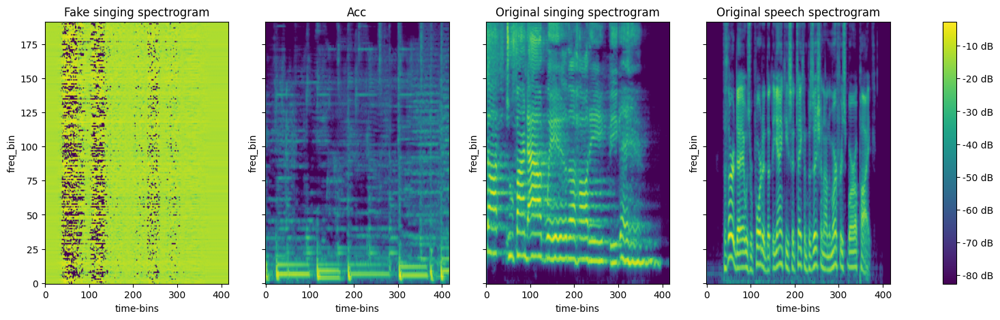

Running batch 1
d_loss: 10.722103118896484; built of 'd_loss_whole:9.716732025146484' & 'd_loss_vocal':1.00537109375
g_loss: -2.802274703979492; built of 'g_loss_whole:-8.274755477905273' & 'g_loss_vocal:-0.00519454013556242' & 'mae_loss_speech:5.477675437927246'
Running batch 2
d_loss: 7.403362274169922; built of 'd_loss_whole:6.398290634155273' & 'd_loss_vocal':1.0050716400146484
g_loss: -0.5158491134643555; built of 'g_loss_whole:-5.250997066497803' & 'g_loss_vocal:-0.0049677761271595955' & 'mae_loss_speech:4.740115642547607'
Running batch 3
d_loss: 6.483879089355469; built of 'd_loss_whole:5.47898530960083' & 'd_loss_vocal':1.0048938989639282
g_loss: 0.24229764938354492; built of 'g_loss_whole:-4.395455837249756' & 'g_loss_vocal:-0.00481398543342948' & 'mae_loss_speech:4.6425676345825195'
Running batch 4
d_loss: 7.514921188354492; built of 'd_loss_whole:6.510139465332031' & 'd_loss_vocal':1.00478196144104
g_loss: 0.5128960609436035; built of 'g_loss_whole:-5.424920082092285' & 'g_l

100%|██████████| 1000/1000 [00:07<00:00, 126.41it/s, loss=0.00621, spectral_convergence=-15.1]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 122.79it/s, loss=0.0772, spectral_convergence=-31]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 121.30it/s, loss=0.00951, spectral_convergence=-0.854]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 124.68it/s, loss=0.0123, spectral_convergence=-39.9]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 120.76it/s, loss=0.538, spectral_convergence=-26.9]


display spectrograms


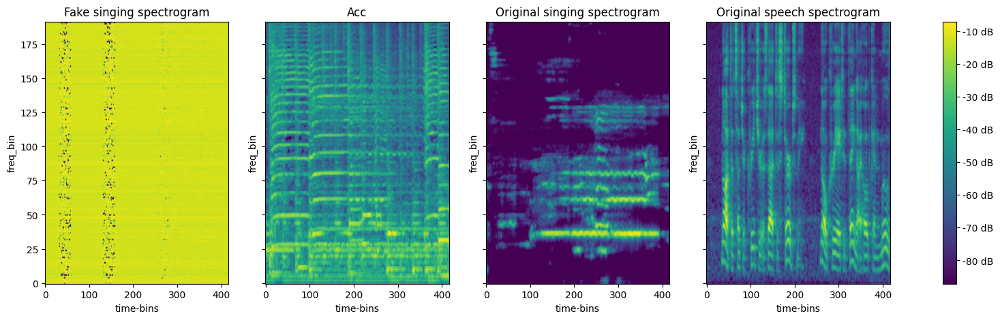

Running batch 1
d_loss: 6.375769138336182; built of 'd_loss_whole:5.371877670288086' & 'd_loss_vocal':1.0038914680480957
g_loss: 0.35892295837402344; built of 'g_loss_whole:-4.328525066375732' & 'g_loss_vocal:-0.0038387449458241463' & 'mae_loss_speech:4.691286563873291'
Running batch 2
d_loss: 8.14493179321289; built of 'd_loss_whole:7.1411027908325195' & 'd_loss_vocal':1.003828763961792
g_loss: -0.9399852752685547; built of 'g_loss_whole:-6.06022310256958' & 'g_loss_vocal:-0.0037762364372611046' & 'mae_loss_speech:5.124013900756836'
Running batch 3
d_loss: 6.861555099487305; built of 'd_loss_whole:5.857832431793213' & 'd_loss_vocal':1.0037224292755127
g_loss: 3.9892616271972656; built of 'g_loss_whole:-4.795221328735352' & 'g_loss_vocal:-0.0036708018742501736' & 'mae_loss_speech:8.788153648376465'
Running batch 4
d_loss: 5.6592206954956055; built of 'd_loss_whole:4.655481815338135' & 'd_loss_vocal':1.0037388801574707
g_loss: 1.020503282546997; built of 'g_loss_whole:-3.614692687988281

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x781540b8f060>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1604, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1587, in _shutdown_workers
    if w.is_alive():
       ^^^^^^^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
AssertionError: can only test a child process


d_loss: 4.896684646606445; built of 'd_loss_whole:3.8945391178131104' & 'd_loss_vocal':1.0021452903747559
g_loss: 4.59049129486084; built of 'g_loss_whole:-2.8631529808044434' & 'g_loss_vocal:-0.0020957847591489553' & 'mae_loss_speech:7.455739974975586'
Running batch 37
d_loss: 7.57710075378418; built of 'd_loss_whole:6.575037002563477' & 'd_loss_vocal':1.0020636320114136
g_loss: -1.099726676940918; built of 'g_loss_whole:-5.473634243011475' & 'g_loss_vocal:-0.0020149804186075926' & 'mae_loss_speech:4.375922679901123'
Running batch 38
d_loss: 3.459904193878174; built of 'd_loss_whole:2.457866668701172' & 'd_loss_vocal':1.0020376443862915
g_loss: 3.5061910152435303; built of 'g_loss_whole:-1.4425581693649292' & 'g_loss_vocal:-0.0019888277165591717' & 'mae_loss_speech:4.950737953186035'
Running batch 39
d_loss: 4.4054765701293945; built of 'd_loss_whole:3.4034929275512695' & 'd_loss_vocal':1.0019835233688354
g_loss: 1.8849647045135498; built of 'g_loss_whole:-2.379970073699951' & 'g_loss

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x781540b8f060>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1604, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1587, in _shutdown_workers
    if w.is_alive():
       ^^^^^^^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
AssertionError: can only test a child process


d_loss: 3.6338014602661133; built of 'd_loss_whole:2.631840229034424' & 'd_loss_vocal':1.0019611120224
g_loss: 17.884632110595703; built of 'g_loss_whole:-1.6181339025497437' & 'g_loss_vocal:-0.001910459715873003' & 'mae_loss_speech:19.504676818847656'
Running batch 41
d_loss: 4.1720380783081055; built of 'd_loss_whole:3.1701815128326416' & 'd_loss_vocal':1.0018565654754639
g_loss: 4.67673397064209; built of 'g_loss_whole:-2.1507694721221924' & 'g_loss_vocal:-0.0018071692902594805' & 'mae_loss_speech:6.829310417175293'
Running batch 42
d_loss: 4.083183288574219; built of 'd_loss_whole:3.081322431564331' & 'd_loss_vocal':1.0018609762191772
g_loss: 2.789541006088257; built of 'g_loss_whole:-2.0625412464141846' & 'g_loss_vocal:-0.00181091099511832' & 'mae_loss_speech:4.853893280029297'
Running batch 43
d_loss: 6.0395002365112305; built of 'd_loss_whole:5.037688732147217' & 'd_loss_vocal':1.0018113851547241
g_loss: 1.2638792991638184; built of 'g_loss_whole:-3.977510929107666' & 'g_loss_vo

100%|██████████| 1000/1000 [00:08<00:00, 119.46it/s, loss=0.00541, spectral_convergence=-16.1]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 119.04it/s, loss=0.516, spectral_convergence=-23]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 121.30it/s, loss=0.00371, spectral_convergence=-8.95]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 119.67it/s, loss=0.02, spectral_convergence=-27.9]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 115.78it/s, loss=0.785, spectral_convergence=-25.6]


display spectrograms


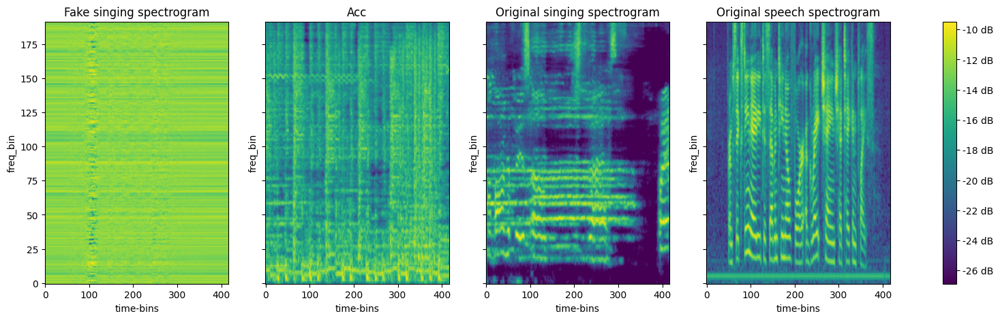

Running batch 101
d_loss: 2.7772250175476074; built of 'd_loss_whole:1.7779226303100586' & 'd_loss_vocal':0.9993025064468384
g_loss: 4.046938419342041; built of 'g_loss_whole:-0.7631943225860596' & 'g_loss_vocal:0.0006811934290453792' & 'mae_loss_speech:4.809451580047607'
Running batch 102
d_loss: 3.0815553665161133; built of 'd_loss_whole:2.082244873046875' & 'd_loss_vocal':0.9993105530738831
g_loss: 4.7439045906066895; built of 'g_loss_whole:-1.0428061485290527' & 'g_loss_vocal:0.0006847887416370213' & 'mae_loss_speech:5.7860260009765625'
Running batch 103
d_loss: 3.075045585632324; built of 'd_loss_whole:2.0757980346679688' & 'd_loss_vocal':0.9992474913597107
g_loss: 8.050192832946777; built of 'g_loss_whole:-1.0486273765563965' & 'g_loss_vocal:0.0007541357190348208' & 'mae_loss_speech:9.098066329956055'
Running batch 104
d_loss: 2.870542287826538; built of 'd_loss_whole:1.8713003396987915' & 'd_loss_vocal':0.9992418885231018
g_loss: 13.397984504699707; built of 'g_loss_whole:-0.845

100%|██████████| 1000/1000 [00:09<00:00, 110.92it/s, loss=0.00553, spectral_convergence=-16]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 115.07it/s, loss=1.97, spectral_convergence=-13.7]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 119.26it/s, loss=0.00268, spectral_convergence=-8.78]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 112.91it/s, loss=0.00594, spectral_convergence=-34.6]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 119.78it/s, loss=7.11, spectral_convergence=-19.7]


display spectrograms


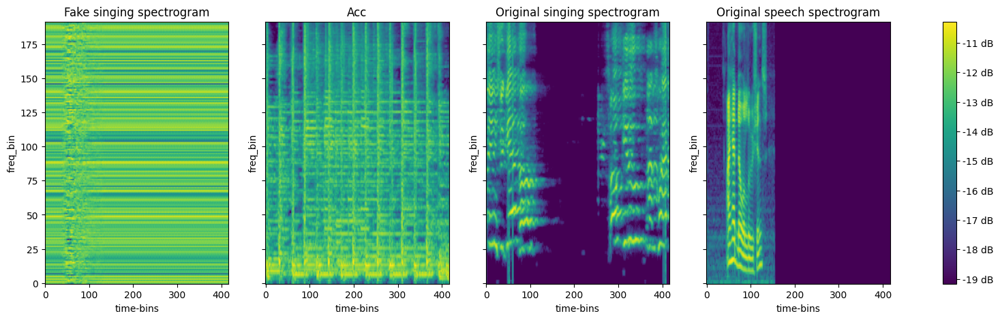

Running batch 1
d_loss: 2.8043205738067627; built of 'd_loss_whole:1.8046941757202148' & 'd_loss_vocal':0.9996264576911926
g_loss: 4.093105792999268; built of 'g_loss_whole:-0.575310468673706' & 'g_loss_vocal:0.0003775795630645007' & 'mae_loss_speech:4.668038845062256'
Running batch 2
d_loss: 2.5513298511505127; built of 'd_loss_whole:1.5516974925994873' & 'd_loss_vocal':0.9996324181556702
g_loss: 4.494688510894775; built of 'g_loss_whole:-0.5204908847808838' & 'g_loss_vocal:0.0003718859807122499' & 'mae_loss_speech:5.01480770111084'
Running batch 3
d_loss: 2.654747724533081; built of 'd_loss_whole:1.655078411102295' & 'd_loss_vocal':0.9996693134307861
g_loss: 4.542842388153076; built of 'g_loss_whole:-0.2509946823120117' & 'g_loss_vocal:0.00033515566610731184' & 'mae_loss_speech:4.793501853942871'
Running batch 4
d_loss: 2.731133222579956; built of 'd_loss_whole:1.7315735816955566' & 'd_loss_vocal':0.9995597004890442
g_loss: 5.262914657592773; built of 'g_loss_whole:-0.592502176761627

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x781540b8f060>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1604, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1587, in _shutdown_workers
    if w.is_alive():
       ^^^^^^^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
AssertionError: can only test a child process


d_loss: 2.438499927520752; built of 'd_loss_whole:1.4390047788619995' & 'd_loss_vocal':0.9994951486587524
g_loss: 3.626495122909546; built of 'g_loss_whole:-0.16304755210876465' & 'g_loss_vocal:0.0005098182591609657' & 'mae_loss_speech:3.7890329360961914'
Running batch 43
d_loss: 2.6953482627868652; built of 'd_loss_whole:1.6958433389663696' & 'd_loss_vocal':0.9995049834251404
g_loss: 4.996016025543213; built of 'g_loss_whole:-0.6793005466461182' & 'g_loss_vocal:0.0004999273223802447' & 'mae_loss_speech:5.674816608428955'
Running batch 44
d_loss: 2.3194046020507812; built of 'd_loss_whole:1.3198959827423096' & 'd_loss_vocal':0.9995085000991821
g_loss: 6.642418384552002; built of 'g_loss_whole:-0.29620063304901123' & 'g_loss_vocal:0.0004964519175700843' & 'mae_loss_speech:6.938122749328613'
Running batch 45
d_loss: 2.561706066131592; built of 'd_loss_whole:1.5621600151062012' & 'd_loss_vocal':0.9995459318161011
g_loss: 3.795468807220459; built of 'g_loss_whole:-0.5382865071296692' & 'g_

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x781540b8f060>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1604, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1587, in _shutdown_workers
    if w.is_alive():
       ^^^^^^

Running batch 50


^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
AssertionError: can only test a child process


d_loss: 2.750948905944824; built of 'd_loss_whole:1.7514996528625488' & 'd_loss_vocal':0.9994493126869202
g_loss: 9.484944343566895; built of 'g_loss_whole:-0.2673729360103607' & 'g_loss_vocal:0.0005556413671001792' & 'mae_loss_speech:9.751761436462402'
Running batch 51
d_loss: 2.4130043983459473; built of 'd_loss_whole:1.413473129272461' & 'd_loss_vocal':0.9995313286781311
g_loss: 4.373978614807129; built of 'g_loss_whole:-0.3539925813674927' & 'g_loss_vocal:0.000473625521408394' & 'mae_loss_speech:4.727497577667236'
Running batch 52
d_loss: 2.3331093788146973; built of 'd_loss_whole:1.333601713180542' & 'd_loss_vocal':0.9995077848434448
g_loss: 2.8530869483947754; built of 'g_loss_whole:-0.2845406234264374' & 'g_loss_vocal:0.0004971644375473261' & 'mae_loss_speech:3.1371304988861084'
Running batch 53
d_loss: 2.1963021755218506; built of 'd_loss_whole:1.196755051612854' & 'd_loss_vocal':0.9995470643043518
g_loss: 5.991922378540039; built of 'g_loss_whole:-0.17896902561187744' & 'g_los

100%|██████████| 1000/1000 [00:08<00:00, 120.31it/s, loss=0.0092, spectral_convergence=-10.6]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 120.20it/s, loss=0.0872, spectral_convergence=-27.9]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 120.46it/s, loss=0.00339, spectral_convergence=-13.7]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 120.02it/s, loss=0.0111, spectral_convergence=-38.6]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 123.84it/s, loss=1.32, spectral_convergence=-19]


display spectrograms


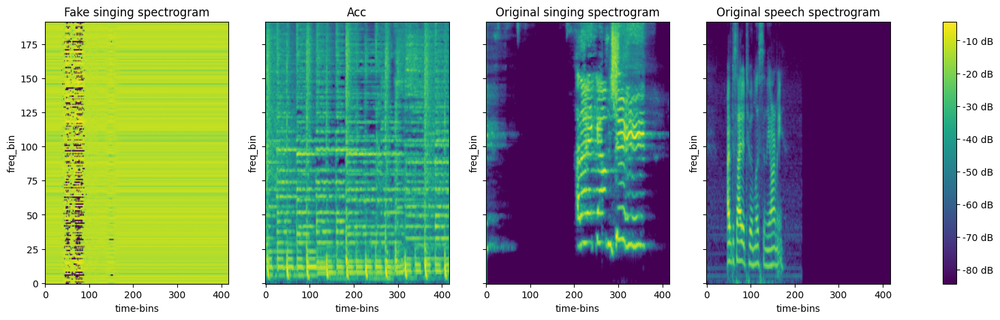

Running batch 101
d_loss: 2.6300017833709717; built of 'd_loss_whole:1.6306859254837036' & 'd_loss_vocal':0.9993159174919128
g_loss: 4.866322994232178; built of 'g_loss_whole:-0.29800111055374146' & 'g_loss_vocal:0.0006893624668009579' & 'mae_loss_speech:5.163634777069092'
Running batch 102
d_loss: 2.6751842498779297; built of 'd_loss_whole:1.6758619546890259' & 'd_loss_vocal':0.9993224143981934
g_loss: 2.678813934326172; built of 'g_loss_whole:-0.041796036064624786' & 'g_loss_vocal:0.0006829379126429558' & 'mae_loss_speech:2.7199270725250244'
Running batch 103
d_loss: 2.40425705909729; built of 'd_loss_whole:1.4049537181854248' & 'd_loss_vocal':0.99930340051651
g_loss: 4.489001274108887; built of 'g_loss_whole:-0.0431620255112648' & 'g_loss_vocal:0.0007019424228928983' & 'mae_loss_speech:4.531461238861084'
Running batch 104
d_loss: 2.473870277404785; built of 'd_loss_whole:1.474658727645874' & 'd_loss_vocal':0.9992116689682007
g_loss: 9.678951263427734; built of 'g_loss_whole:-0.20869

100%|██████████| 1000/1000 [00:08<00:00, 114.11it/s, loss=0.0318, spectral_convergence=-2.61]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 119.20it/s, loss=0.339, spectral_convergence=-23.7]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 111.99it/s, loss=0.00722, spectral_convergence=-14.1]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 111.34it/s, loss=0.213, spectral_convergence=-19.8]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 117.98it/s, loss=1.95, spectral_convergence=-20]


display spectrograms


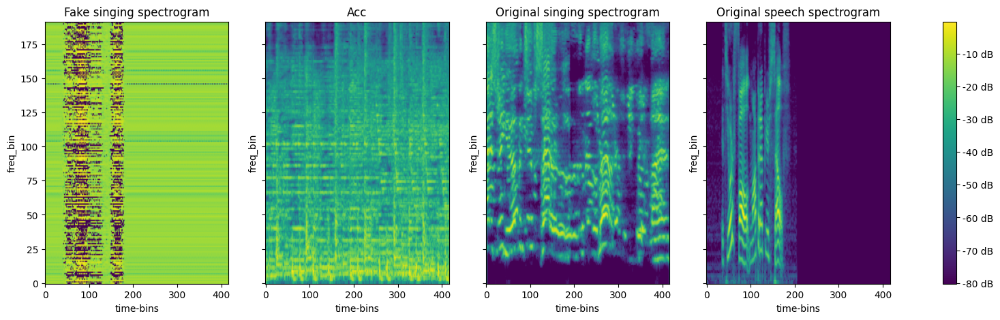

Running batch 201
d_loss: 2.2145347595214844; built of 'd_loss_whole:1.215419888496399' & 'd_loss_vocal':0.9991148710250854
g_loss: 4.4489617347717285; built of 'g_loss_whole:0.5242191553115845' & 'g_loss_vocal:0.0008902675472199917' & 'mae_loss_speech:3.9238524436950684'
Running batch 202
d_loss: 1.7372236251831055; built of 'd_loss_whole:0.7381633520126343' & 'd_loss_vocal':0.9990602731704712
g_loss: 5.00700569152832; built of 'g_loss_whole:0.2783302962779999' & 'g_loss_vocal:0.0009447474731132388' & 'mae_loss_speech:4.727730751037598'
Running batch 203
d_loss: 2.296696424484253; built of 'd_loss_whole:1.2975950241088867' & 'd_loss_vocal':0.9991014003753662
g_loss: 4.144009590148926; built of 'g_loss_whole:-0.014846962876617908' & 'g_loss_vocal:0.0009037160198204219' & 'mae_loss_speech:4.157952785491943'
Running batch 204
d_loss: 2.1549620628356934; built of 'd_loss_whole:1.1558775901794434' & 'd_loss_vocal':0.9990844130516052
g_loss: 4.3585333824157715; built of 'g_loss_whole:0.0916

100%|██████████| 1000/1000 [00:08<00:00, 114.20it/s, loss=0.0116, spectral_convergence=-8.43]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 117.65it/s, loss=0.409, spectral_convergence=-22.2]


generated speech:


100%|██████████| 1000/1000 [00:09<00:00, 110.80it/s, loss=0.00605, spectral_convergence=-15.5]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 106.24it/s, loss=0.102, spectral_convergence=-19.6]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 118.16it/s, loss=0.0155, spectral_convergence=-39.7]


display spectrograms


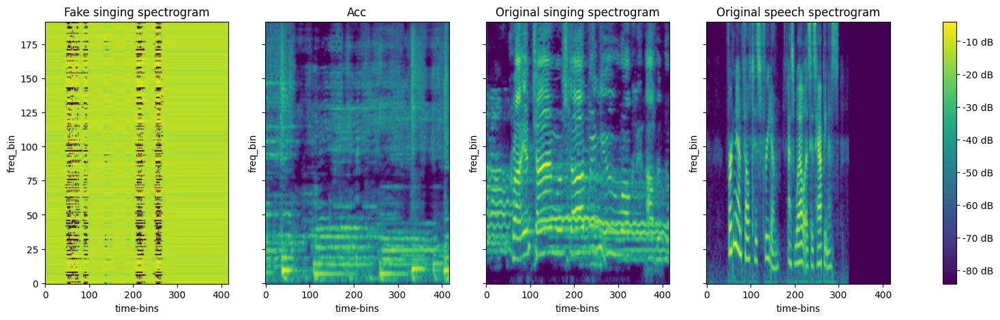

Running batch 1
d_loss: 1.6413793563842773; built of 'd_loss_whole:0.6426815986633301' & 'd_loss_vocal':0.9986977577209473
g_loss: 6.135208606719971; built of 'g_loss_whole:0.3807066082954407' & 'g_loss_vocal:0.0013070437125861645' & 'mae_loss_speech:5.753194808959961'
Running batch 2
d_loss: 2.0470194816589355; built of 'd_loss_whole:1.0481741428375244' & 'd_loss_vocal':0.9988453388214111
g_loss: 3.650177001953125; built of 'g_loss_whole:-0.012231523171067238' & 'g_loss_vocal:0.0011596177937462926' & 'mae_loss_speech:3.6612489223480225'
Running batch 3
d_loss: 1.9833848476409912; built of 'd_loss_whole:0.9845133423805237' & 'd_loss_vocal':0.9988714456558228
g_loss: 5.283557415008545; built of 'g_loss_whole:0.06316476315259933' & 'g_loss_vocal:0.0011336511233821511' & 'mae_loss_speech:5.219258785247803'
Running batch 4
d_loss: 1.8516676425933838; built of 'd_loss_whole:0.8529032468795776' & 'd_loss_vocal':0.9987643957138062
g_loss: 4.227234363555908; built of 'g_loss_whole:0.1945408135

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x781540b8f060>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1604, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1587, in _shutdown_workers
    if w.is_alive():
       ^^^^^^^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
AssertionError: can only test a child process


d_loss: 1.4837616682052612; built of 'd_loss_whole:0.48514431715011597' & 'd_loss_vocal':0.9986173510551453
g_loss: 7.272914409637451; built of 'g_loss_whole:0.9720038771629333' & 'g_loss_vocal:0.0013878021854907274' & 'mae_loss_speech:6.299522876739502'
Running batch 51
d_loss: 1.9364792108535767; built of 'd_loss_whole:0.9378288984298706' & 'd_loss_vocal':0.998650312423706
g_loss: 4.679438591003418; built of 'g_loss_whole:0.060554563999176025' & 'g_loss_vocal:0.0013550053117796779' & 'mae_loss_speech:4.617528915405273'
Running batch 52
d_loss: 1.7226265668869019; built of 'd_loss_whole:0.724123477935791' & 'd_loss_vocal':0.9985030889511108
g_loss: 9.16522216796875; built of 'g_loss_whole:0.5316739678382874' & 'g_loss_vocal:0.001501802122220397' & 'mae_loss_speech:8.632046699523926'
Running batch 53
d_loss: 2.14212965965271; built of 'd_loss_whole:1.1434730291366577' & 'd_loss_vocal':0.9986566305160522
g_loss: 4.889591217041016; built of 'g_loss_whole:0.11623258888721466' & 'g_loss_vo

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x781540b8f060>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1604, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1587, in _shutdown_workers
    if w.is_alive():
       ^^^^^^^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
AssertionError: can only test a child process


d_loss: 2.323915958404541; built of 'd_loss_whole:1.3253878355026245' & 'd_loss_vocal':0.998528003692627
g_loss: 7.48304557800293; built of 'g_loss_whole:-0.30444231629371643' & 'g_loss_vocal:0.0014769441913813353' & 'mae_loss_speech:7.7860107421875'
Running batch 55
d_loss: 1.7191354036331177; built of 'd_loss_whole:0.7205389738082886' & 'd_loss_vocal':0.9985964298248291
g_loss: 6.560934066772461; built of 'g_loss_whole:0.3009627163410187' & 'g_loss_vocal:0.001408700249157846' & 'mae_loss_speech:6.2585625648498535'
Running batch 56
d_loss: 1.781392216682434; built of 'd_loss_whole:0.7828187942504883' & 'd_loss_vocal':0.9985734224319458
g_loss: 4.766939163208008; built of 'g_loss_whole:0.3913281559944153' & 'g_loss_vocal:0.0014317329041659832' & 'mae_loss_speech:4.374179363250732'
Running batch 57
d_loss: 1.9159040451049805; built of 'd_loss_whole:0.9173233509063721' & 'd_loss_vocal':0.9985806345939636
g_loss: 4.754907131195068; built of 'g_loss_whole:0.2690456509590149' & 'g_loss_voca

100%|██████████| 1000/1000 [00:08<00:00, 114.47it/s, loss=0.0106, spectral_convergence=-10.2]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 118.06it/s, loss=0.0687, spectral_convergence=-33.1]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 115.77it/s, loss=0.00534, spectral_convergence=-14.5]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 115.62it/s, loss=0.0148, spectral_convergence=-37.9]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 113.47it/s, loss=0.634, spectral_convergence=-21.4]


display spectrograms


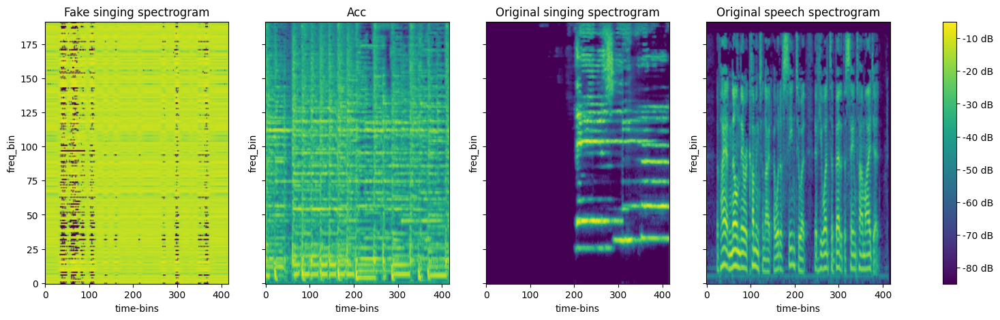

Running batch 101
d_loss: 1.747915506362915; built of 'd_loss_whole:0.7492425441741943' & 'd_loss_vocal':0.9986729621887207
g_loss: 6.239574432373047; built of 'g_loss_whole:0.29178300499916077' & 'g_loss_vocal:0.001331949606537819' & 'mae_loss_speech:5.9464592933654785'
Running batch 102
d_loss: 1.3281867504119873; built of 'd_loss_whole:0.3295496106147766' & 'd_loss_vocal':0.9986370801925659
g_loss: 5.8544111251831055; built of 'g_loss_whole:0.740376889705658' & 'g_loss_vocal:0.0013677033130079508' & 'mae_loss_speech:5.112666606903076'
Running batch 103
d_loss: 1.523158311843872; built of 'd_loss_whole:0.5245810747146606' & 'd_loss_vocal':0.9985771775245667
g_loss: 16.521360397338867; built of 'g_loss_whole:0.5151227712631226' & 'g_loss_vocal:0.0014275327557697892' & 'mae_loss_speech:16.004810333251953'
Running batch 104
d_loss: 1.4621901512145996; built of 'd_loss_whole:0.46348536014556885' & 'd_loss_vocal':0.998704731464386
g_loss: 4.957045555114746; built of 'g_loss_whole:0.592075

100%|██████████| 1000/1000 [00:08<00:00, 111.38it/s, loss=0.0453, spectral_convergence=-3.56]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 117.41it/s, loss=2.05, spectral_convergence=-17.7]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 113.54it/s, loss=0.0152, spectral_convergence=-13.5]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 121.12it/s, loss=0.128, spectral_convergence=-35.2]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 114.69it/s, loss=0.277, spectral_convergence=-29.2]


display spectrograms


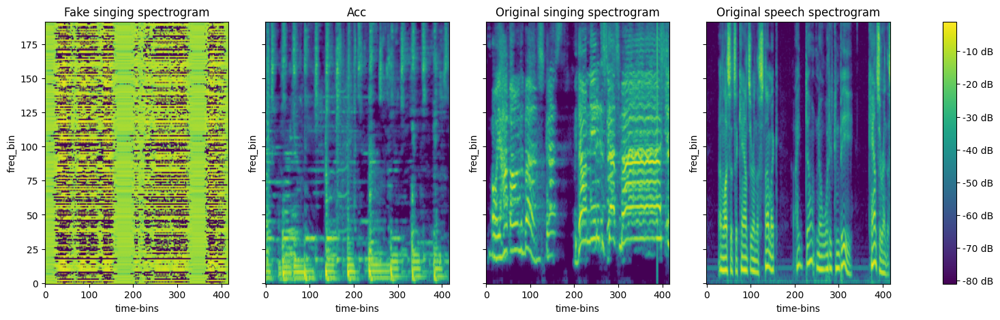

Running batch 201
d_loss: 1.218536376953125; built of 'd_loss_whole:0.2203570008277893' & 'd_loss_vocal':0.9981793761253357
g_loss: 6.832236289978027; built of 'g_loss_whole:0.8008124232292175' & 'g_loss_vocal:0.0018253937596455216' & 'mae_loss_speech:6.029598712921143'
Running batch 202
d_loss: 1.8216207027435303; built of 'd_loss_whole:0.8234603404998779' & 'd_loss_vocal':0.9981603622436523
g_loss: 13.307372093200684; built of 'g_loss_whole:1.8821654319763184' & 'g_loss_vocal:0.0018443382577970624' & 'mae_loss_speech:11.423362731933594'
Running batch 203
d_loss: 1.1700800657272339; built of 'd_loss_whole:0.17181426286697388' & 'd_loss_vocal':0.99826580286026
g_loss: 6.35507345199585; built of 'g_loss_whole:0.9640762805938721' & 'g_loss_vocal:0.0017393032321706414' & 'mae_loss_speech:5.389257907867432'
Running batch 204
d_loss: 0.9981822371482849; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9981822371482849
g_loss: 6.265981197357178; built of 'g_loss_whole:1.4835766553878784' & 'g_

100%|██████████| 1000/1000 [00:09<00:00, 107.24it/s, loss=0.0456, spectral_convergence=-3.4]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 115.37it/s, loss=0.069, spectral_convergence=-20.2]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 117.23it/s, loss=0.016, spectral_convergence=-13.2]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 117.51it/s, loss=0.33, spectral_convergence=-23.5]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 115.51it/s, loss=0.627, spectral_convergence=-19.4]


display spectrograms


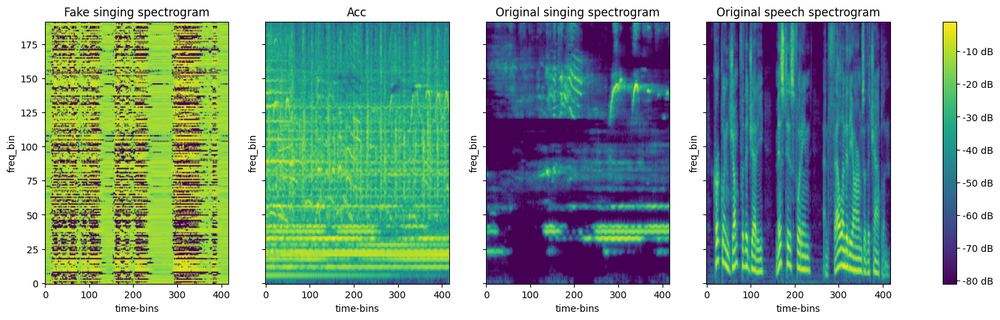

Running batch 301
d_loss: 1.777550220489502; built of 'd_loss_whole:0.779717206954956' & 'd_loss_vocal':0.9978329539299011
g_loss: 6.594365119934082; built of 'g_loss_whole:1.4153591394424438' & 'g_loss_vocal:0.0021723583340644836' & 'mae_loss_speech:5.176833629608154'
Running batch 302
d_loss: 0.9977393746376038; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9977393746376038
g_loss: 7.095100402832031; built of 'g_loss_whole:1.2165247201919556' & 'g_loss_vocal:0.0022654086351394653' & 'mae_loss_speech:5.876310348510742'
Running batch 303
d_loss: 0.9977355599403381; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9977355599403381
g_loss: 8.15769100189209; built of 'g_loss_whole:1.1471397876739502' & 'g_loss_vocal:0.0022693518549203873' & 'mae_loss_speech:7.00828218460083'
Running batch 304
d_loss: 1.4795405864715576; built of 'd_loss_whole:0.48178040981292725' & 'd_loss_vocal':0.9977601170539856
g_loss: 4.854061603546143; built of 'g_loss_whole:0.5410261750221252' & 'g_loss_vocal:0.0022

100%|██████████| 1000/1000 [00:08<00:00, 118.56it/s, loss=0.0181, spectral_convergence=-6.23]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 118.68it/s, loss=0.631, spectral_convergence=-21.7]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 113.41it/s, loss=0.00725, spectral_convergence=-13.9]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 114.42it/s, loss=0.0902, spectral_convergence=-24.3]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 115.57it/s, loss=0.132, spectral_convergence=-39.4]


display spectrograms


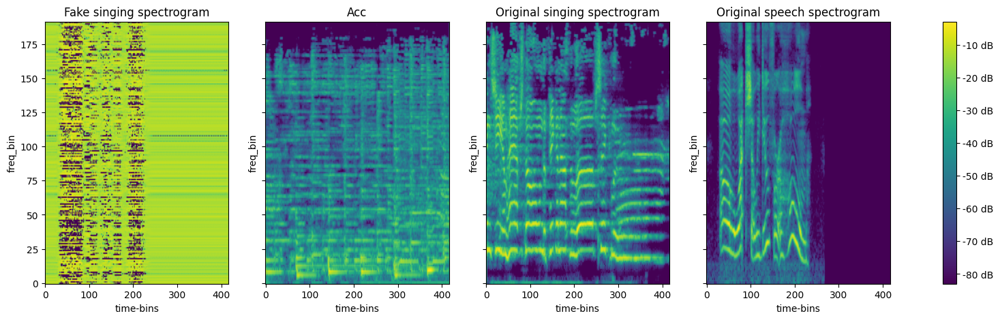

Running batch 401
d_loss: 1.3849716186523438; built of 'd_loss_whole:0.38768261671066284' & 'd_loss_vocal':0.9972890615463257
g_loss: 8.095726013183594; built of 'g_loss_whole:0.6399211287498474' & 'g_loss_vocal:0.002715841168537736' & 'mae_loss_speech:7.453089237213135'
Running batch 402
d_loss: 1.0178415775299072; built of 'd_loss_whole:0.020529747009277344' & 'd_loss_vocal':0.9973118901252747
g_loss: 7.478730201721191; built of 'g_loss_whole:0.9908735752105713' & 'g_loss_vocal:0.0026931571774184704' & 'mae_loss_speech:6.48516321182251'
Running batch 403
d_loss: 1.2755779027938843; built of 'd_loss_whole:0.27824872732162476' & 'd_loss_vocal':0.9973291754722595
g_loss: 4.763065338134766; built of 'g_loss_whole:0.7516040802001953' & 'g_loss_vocal:0.002675974741578102' & 'mae_loss_speech:4.008785247802734'
Running batch 404
d_loss: 1.1516096591949463; built of 'd_loss_whole:0.15428465604782104' & 'd_loss_vocal':0.9973250031471252
g_loss: 3.9002606868743896; built of 'g_loss_whole:0.8763

100%|██████████| 1000/1000 [00:07<00:00, 125.13it/s, loss=0.0126, spectral_convergence=-8.19]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 118.66it/s, loss=1.39, spectral_convergence=-18.3]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 117.29it/s, loss=0.00692, spectral_convergence=-16.1]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 117.22it/s, loss=0.0373, spectral_convergence=-24.4]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 119.71it/s, loss=0.133, spectral_convergence=-25.6]


display spectrograms


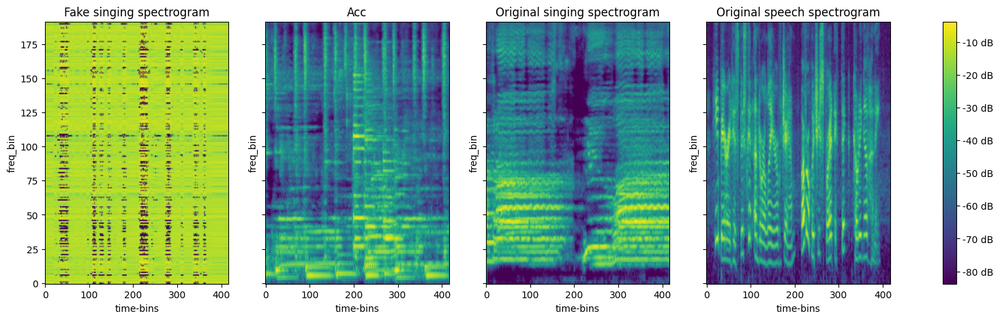

Running batch 501
d_loss: 1.069340705871582; built of 'd_loss_whole:0.07204604148864746' & 'd_loss_vocal':0.9972947239875793
g_loss: 7.571481704711914; built of 'g_loss_whole:3.557215690612793' & 'g_loss_vocal:0.002709799911826849' & 'mae_loss_speech:4.011556148529053'
Running batch 502
d_loss: 1.19535231590271; built of 'd_loss_whole:0.1980525255203247' & 'd_loss_vocal':0.99729984998703
g_loss: 7.355306625366211; built of 'g_loss_whole:1.2725757360458374' & 'g_loss_vocal:0.0027049058116972446' & 'mae_loss_speech:6.080026149749756'
Running batch 503
d_loss: 1.4519109725952148; built of 'd_loss_whole:0.4546370506286621' & 'd_loss_vocal':0.9972739219665527
g_loss: 5.752321243286133; built of 'g_loss_whole:0.5400567054748535' & 'g_loss_vocal:0.002730811480432749' & 'mae_loss_speech:5.20953369140625'
Running batch 504
d_loss: 0.9972845315933228; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9972845315933228
g_loss: 4.447357654571533; built of 'g_loss_whole:1.047368049621582' & 'g_loss_voc

100%|██████████| 1000/1000 [00:08<00:00, 119.65it/s, loss=0.01, spectral_convergence=-9.91]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 118.09it/s, loss=0.314, spectral_convergence=-24]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 115.70it/s, loss=0.00462, spectral_convergence=-16.6]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 119.53it/s, loss=0.0222, spectral_convergence=-32.9]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 115.37it/s, loss=2.7, spectral_convergence=-17.5]


display spectrograms


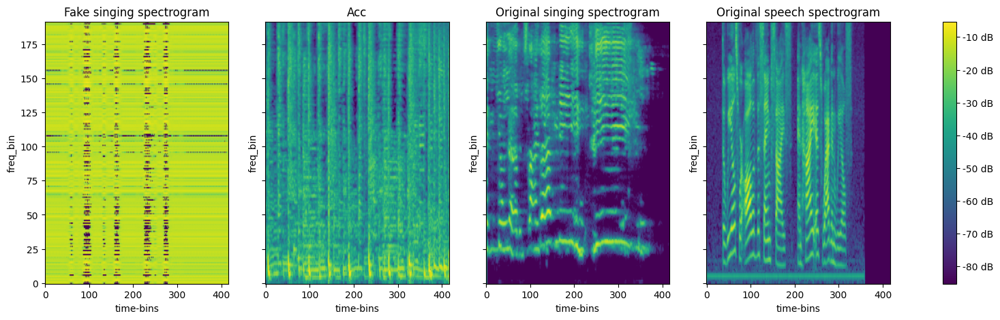

Running batch 601
d_loss: 1.05733323097229; built of 'd_loss_whole:0.06047177314758301' & 'd_loss_vocal':0.996861457824707
g_loss: 6.688727855682373; built of 'g_loss_whole:1.247249722480774' & 'g_loss_vocal:0.003143591107800603' & 'mae_loss_speech:5.4383344650268555'
Running batch 602
d_loss: 1.5786707401275635; built of 'd_loss_whole:0.5080305933952332' & 'd_loss_vocal':1.0706400871276855
g_loss: 4.133538246154785; built of 'g_loss_whole:0.9796109199523926' & 'g_loss_vocal:0.002950257621705532' & 'mae_loss_speech:3.15097713470459'
Running batch 603
d_loss: 1.6280264854431152; built of 'd_loss_whole:0.6310228109359741' & 'd_loss_vocal':0.9970036149024963
g_loss: 7.60317325592041; built of 'g_loss_whole:1.9936715364456177' & 'g_loss_vocal:0.002913622884079814' & 'mae_loss_speech:5.606588363647461'
Running batch 604
d_loss: 1.7243683338165283; built of 'd_loss_whole:0.7272874116897583' & 'd_loss_vocal':0.99708092212677
g_loss: 5.425281524658203; built of 'g_loss_whole:0.2689514756202698

100%|██████████| 1000/1000 [00:08<00:00, 114.02it/s, loss=0.0176, spectral_convergence=-3.32]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 114.08it/s, loss=0.0943, spectral_convergence=-26.6]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 117.98it/s, loss=0.00362, spectral_convergence=-17.5]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 116.92it/s, loss=0.0482, spectral_convergence=-22.4]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 117.73it/s, loss=0.254, spectral_convergence=-17.9]


display spectrograms


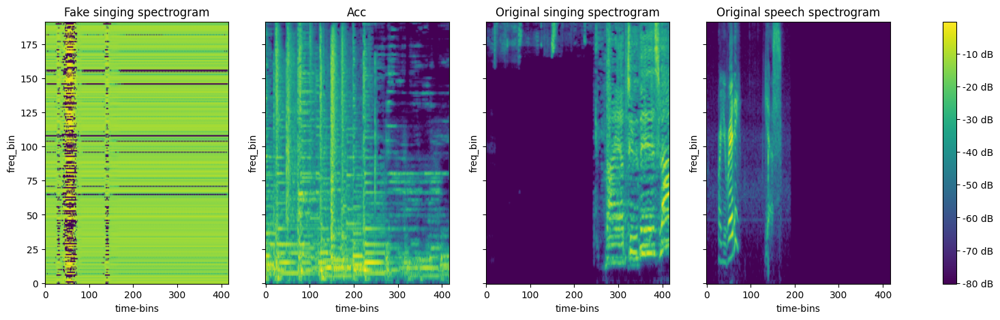

Running batch 701
d_loss: 0.9968153834342957; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9968153834342957
g_loss: 7.409488677978516; built of 'g_loss_whole:1.2342718839645386' & 'g_loss_vocal:0.0031893423292785883' & 'mae_loss_speech:6.172027587890625'
Running batch 702
d_loss: 1.0036885738372803; built of 'd_loss_whole:0.006863772869110107' & 'd_loss_vocal':0.9968248605728149
g_loss: 7.4901251792907715; built of 'g_loss_whole:1.0049934387207031' & 'g_loss_vocal:0.0031798970885574818' & 'mae_loss_speech:6.481951713562012'
Running batch 703
d_loss: 1.5570425987243652; built of 'd_loss_whole:0.560245931148529' & 'd_loss_vocal':0.9967966675758362
g_loss: 6.209213733673096; built of 'g_loss_whole:2.2205100059509277' & 'g_loss_vocal:0.003207789035513997' & 'mae_loss_speech:3.9854960441589355'
Running batch 704
d_loss: 1.2907919883728027; built of 'd_loss_whole:0.29400068521499634' & 'd_loss_vocal':0.9967913031578064
g_loss: 3.7023818492889404; built of 'g_loss_whole:0.7031233310699463' 

100%|██████████| 1000/1000 [00:08<00:00, 112.13it/s, loss=0.0167, spectral_convergence=-6.86]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 113.51it/s, loss=0.355, spectral_convergence=-26.3]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 115.21it/s, loss=0.011, spectral_convergence=-14.1]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 112.46it/s, loss=0.0293, spectral_convergence=-37.6]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 114.49it/s, loss=0.0953, spectral_convergence=-30.2]


display spectrograms


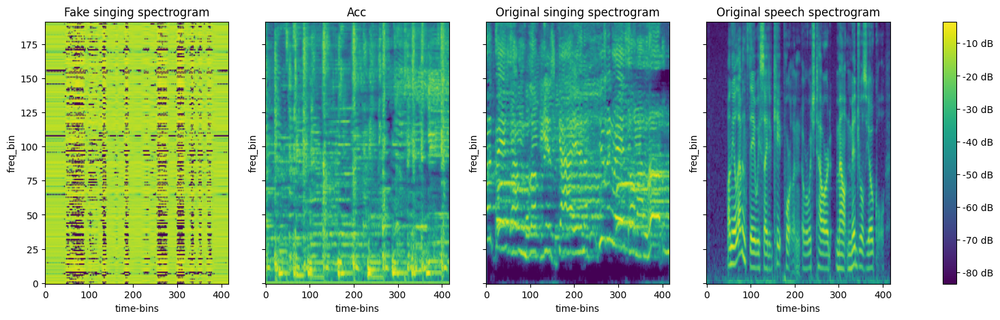

Running batch 801
d_loss: 2.3278212547302246; built of 'd_loss_whole:1.3314142227172852' & 'd_loss_vocal':0.996407151222229
g_loss: 6.406108856201172; built of 'g_loss_whole:2.3666536808013916' & 'g_loss_vocal:0.00359784415923059' & 'mae_loss_speech:4.035857677459717'
Running batch 802
d_loss: 0.9963823556900024; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9963823556900024
g_loss: 12.12276554107666; built of 'g_loss_whole:2.0515663623809814' & 'g_loss_vocal:0.003622104413807392' & 'mae_loss_speech:10.067577362060547'
Running batch 803
d_loss: 0.9963651895523071; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9963651895523071
g_loss: 5.310847759246826; built of 'g_loss_whole:1.4148504734039307' & 'g_loss_vocal:0.0036396016366779804' & 'mae_loss_speech:3.892357587814331'
Running batch 804
d_loss: 1.4099456071853638; built of 'd_loss_whole:0.41360342502593994' & 'd_loss_vocal':0.9963421821594238
g_loss: 5.2788496017456055; built of 'g_loss_whole:0.6427944898605347' & 'g_loss_vocal:0.00

100%|██████████| 1000/1000 [00:08<00:00, 119.12it/s, loss=0.0183, spectral_convergence=-5.52]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 116.27it/s, loss=0.449, spectral_convergence=-25.8]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 116.98it/s, loss=0.0104, spectral_convergence=-15.1]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 114.06it/s, loss=0.0702, spectral_convergence=-28.2]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 111.36it/s, loss=0.17, spectral_convergence=-22.9]


display spectrograms


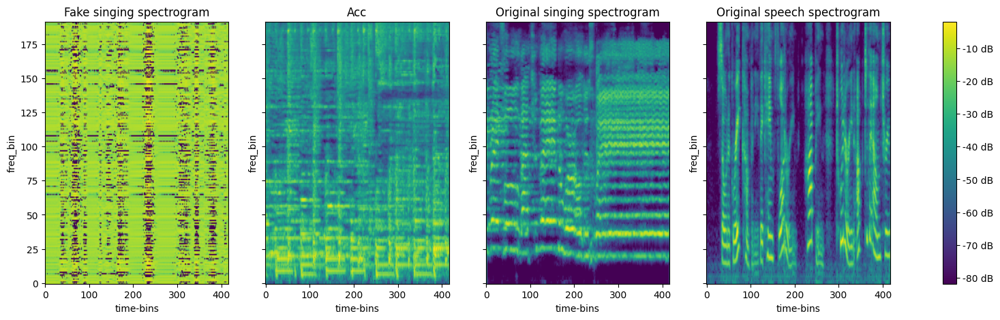

Running batch 901
d_loss: 0.9959128499031067; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9959128499031067
g_loss: 6.767920970916748; built of 'g_loss_whole:1.968876838684082' & 'g_loss_vocal:0.004092738963663578' & 'mae_loss_speech:4.794951438903809'
Running batch 902
d_loss: 0.9958791732788086; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9958791732788086
g_loss: 6.410102367401123; built of 'g_loss_whole:1.9142143726348877' & 'g_loss_vocal:0.004126367159187794' & 'mae_loss_speech:4.491761684417725'
Running batch 903
d_loss: 2.3485398292541504; built of 'd_loss_whole:1.3526644706726074' & 'd_loss_vocal':0.9958752989768982
g_loss: 6.35251522064209; built of 'g_loss_whole:2.1392822265625' & 'g_loss_vocal:0.004130173474550247' & 'mae_loss_speech:4.209102630615234'
Running batch 904
d_loss: 1.6531221866607666; built of 'd_loss_whole:0.6572129726409912' & 'd_loss_vocal':0.9959091544151306
g_loss: 6.4665374755859375; built of 'g_loss_whole:2.1364009380340576' & 'g_loss_vocal:0.00409614

100%|██████████| 1000/1000 [00:08<00:00, 120.64it/s, loss=0.027, spectral_convergence=-4.47]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 117.57it/s, loss=0.142, spectral_convergence=-26.6]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 115.24it/s, loss=0.0149, spectral_convergence=-14.9]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 118.83it/s, loss=0.0806, spectral_convergence=-27.4]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 122.71it/s, loss=0.901, spectral_convergence=-29.8]


display spectrograms


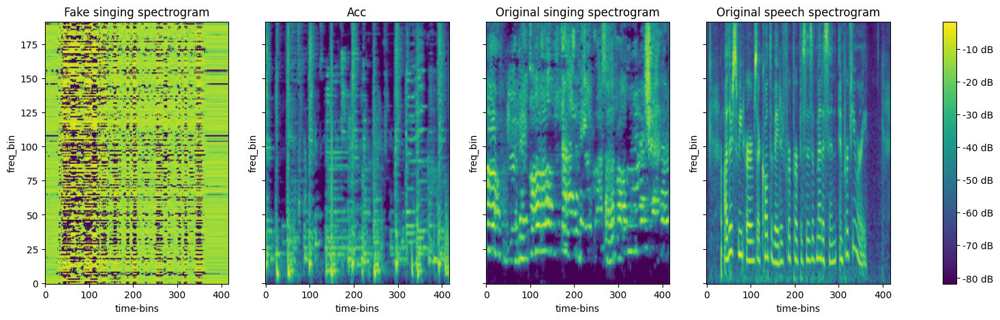

Running batch 1001
d_loss: 0.9954107999801636; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9954107999801636
g_loss: 6.155819416046143; built of 'g_loss_whole:1.6600768566131592' & 'g_loss_vocal:0.00459514744579792' & 'mae_loss_speech:4.491147518157959'
Running batch 1002
d_loss: 0.9953610897064209; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9953610897064209
g_loss: 5.786212921142578; built of 'g_loss_whole:1.5079814195632935' & 'g_loss_vocal:0.004645281005650759' & 'mae_loss_speech:4.273586273193359'
Running batch 1003
d_loss: 1.60172438621521; built of 'd_loss_whole:0.6063653230667114' & 'd_loss_vocal':0.9953590631484985
g_loss: 6.71856164932251; built of 'g_loss_whole:0.42561280727386475' & 'g_loss_vocal:0.004647390451282263' & 'mae_loss_speech:6.288301467895508'
Running batch 1004
d_loss: 0.9953812956809998; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9953812956809998
g_loss: 7.694678783416748; built of 'g_loss_whole:2.455319881439209' & 'g_loss_vocal:0.004624747671186924'

100%|██████████| 1000/1000 [00:08<00:00, 115.12it/s, loss=0.0277, spectral_convergence=-4]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 115.71it/s, loss=0.494, spectral_convergence=-22.4]


generated speech:


100%|██████████| 1000/1000 [00:10<00:00, 98.71it/s, loss=0.0154, spectral_convergence=-15.3]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 100.53it/s, loss=0.226, spectral_convergence=-22.8]


original accompinemant


100%|██████████| 1000/1000 [00:12<00:00, 78.01it/s, loss=0.924, spectral_convergence=-22.5]


display spectrograms


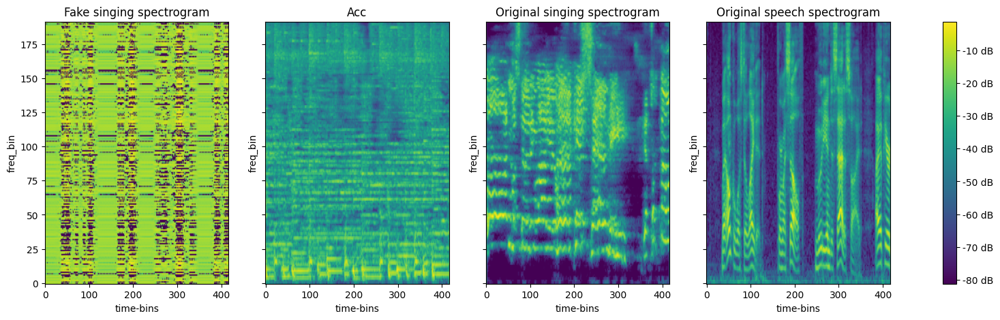

Running batch 1101
d_loss: 0.9948411583900452; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9948411583900452
g_loss: 7.144488334655762; built of 'g_loss_whole:1.85332453250885' & 'g_loss_vocal:0.0051656789146363735' & 'mae_loss_speech:5.2859978675842285'
Running batch 1102
d_loss: 0.9947529435157776; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9947529435157776
g_loss: 8.560612678527832; built of 'g_loss_whole:3.731109380722046' & 'g_loss_vocal:0.005254303105175495' & 'mae_loss_speech:4.824248790740967'
Running batch 1103
d_loss: 1.5191656351089478; built of 'd_loss_whole:0.5242440700531006' & 'd_loss_vocal':0.9949215650558472
g_loss: 7.874617099761963; built of 'g_loss_whole:1.3323893547058105' & 'g_loss_vocal:0.005084970500320196' & 'mae_loss_speech:6.537142753601074'
Running batch 1104
d_loss: 0.994822084903717; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.994822084903717
g_loss: 5.745545387268066; built of 'g_loss_whole:1.4650895595550537' & 'g_loss_vocal:0.005184907000511885

100%|██████████| 1000/1000 [00:08<00:00, 115.82it/s, loss=0.00661, spectral_convergence=-14.1]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 110.00it/s, loss=0.496, spectral_convergence=-15.7]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 113.19it/s, loss=0.00232, spectral_convergence=-13.3]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 116.26it/s, loss=0.00822, spectral_convergence=-34.9]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 114.77it/s, loss=0.249, spectral_convergence=-17.4]


display spectrograms


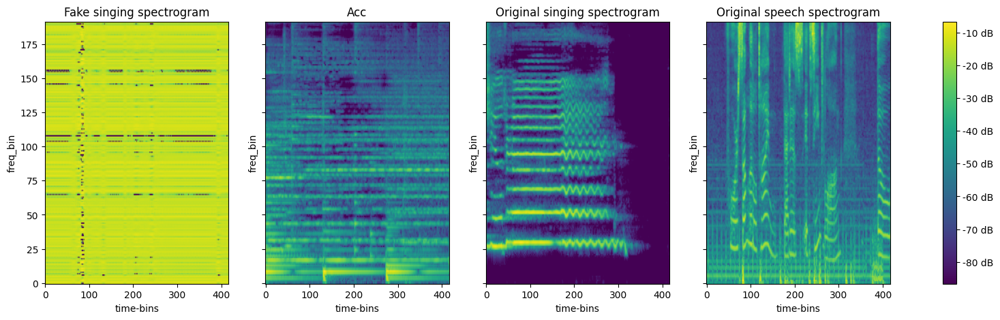

Running batch 1
d_loss: 0.9947603344917297; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9947603344917297
g_loss: 7.746827125549316; built of 'g_loss_whole:2.201362371444702' & 'g_loss_vocal:0.005246677901595831' & 'mae_loss_speech:5.540217876434326'
Running batch 2
d_loss: 0.9947237968444824; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9947237968444824
g_loss: 6.558608055114746; built of 'g_loss_whole:1.6008052825927734' & 'g_loss_vocal:0.005283508915454149' & 'mae_loss_speech:4.952519416809082'
Running batch 3
d_loss: 1.229926586151123; built of 'd_loss_whole:0.2351665496826172' & 'd_loss_vocal':0.9947599768638611
g_loss: 3.7831125259399414; built of 'g_loss_whole:0.7886311411857605' & 'g_loss_vocal:0.00524712260812521' & 'mae_loss_speech:2.989234209060669'
Running batch 4
d_loss: 1.724764108657837; built of 'd_loss_whole:0.7300479412078857' & 'd_loss_vocal':0.9947161674499512
g_loss: 6.912752628326416; built of 'g_loss_whole:1.7413314580917358' & 'g_loss_vocal:0.005290927365422

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x781540b8f060>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1604, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1587, in _shutdown_workers
    if w.is_alive():
       ^^^^^^^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
AssertionError: can only test a child process


d_loss: 1.8528223037719727; built of 'd_loss_whole:0.8583048582077026' & 'd_loss_vocal':0.9945175051689148
g_loss: 8.321005821228027; built of 'g_loss_whole:2.697817325592041' & 'g_loss_vocal:0.005489970091730356' & 'mae_loss_speech:5.6176981925964355'
Running batch 28
d_loss: 0.9944819211959839; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9944819211959839
g_loss: 6.848919868469238; built of 'g_loss_whole:2.3252172470092773' & 'g_loss_vocal:0.0055257598869502544' & 'mae_loss_speech:4.518177032470703'
Running batch 29
d_loss: 0.9945186972618103; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9945186972618103
g_loss: 7.660317420959473; built of 'g_loss_whole:2.0040555000305176' & 'g_loss_vocal:0.0054890867322683334' & 'mae_loss_speech:5.650772571563721'
Running batch 30
d_loss: 2.398792028427124; built of 'd_loss_whole:1.4042388200759888' & 'd_loss_vocal':0.99455326795578
g_loss: 3.0021257400512695; built of 'g_loss_whole:-0.39878761768341064' & 'g_loss_vocal:0.005454251542687416' & '

100%|██████████| 1000/1000 [00:08<00:00, 115.99it/s, loss=0.0152, spectral_convergence=-6.35]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 113.77it/s, loss=0.104, spectral_convergence=-31.1]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 112.63it/s, loss=0.00773, spectral_convergence=-14]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 113.14it/s, loss=0.0414, spectral_convergence=-28.5]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 114.45it/s, loss=0.345, spectral_convergence=-23.8]


display spectrograms


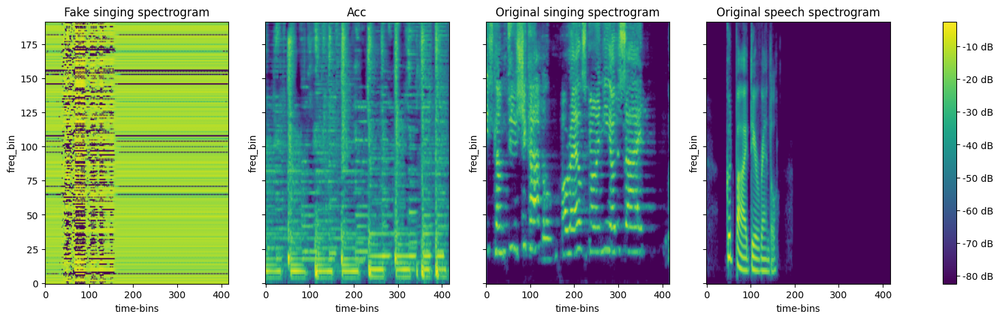

Running batch 1
d_loss: 0.9944483637809753; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9944483637809753
g_loss: 5.728048324584961; built of 'g_loss_whole:1.1143444776535034' & 'g_loss_vocal:0.005559517070651054' & 'mae_loss_speech:4.608144283294678'
Running batch 2
d_loss: 1.3234543800354004; built of 'd_loss_whole:0.3288910388946533' & 'd_loss_vocal':0.9945633411407471
g_loss: 13.444116592407227; built of 'g_loss_whole:0.764359712600708' & 'g_loss_vocal:0.005443874280899763' & 'mae_loss_speech:12.674312591552734'
Running batch 3
d_loss: 0.9944666028022766; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9944666028022766
g_loss: 8.0616455078125; built of 'g_loss_whole:1.4990273714065552' & 'g_loss_vocal:0.005541027523577213' & 'mae_loss_speech:6.557076930999756'
Running batch 4
d_loss: 0.9945142269134521; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9945142269134521
g_loss: 6.703996658325195; built of 'g_loss_whole:1.2505849599838257' & 'g_loss_vocal:0.005493380129337311' & 'mae_l

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x781540b8f060>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1604, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1587, in _shutdown_workers
    if w.is_alive():
       ^^^^^^^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
AssertionError: can only test a child process


d_loss: 1.3115429878234863; built of 'd_loss_whole:0.31676697731018066' & 'd_loss_vocal':0.9947760701179504
g_loss: 5.345541477203369; built of 'g_loss_whole:0.6807985901832581' & 'g_loss_vocal:0.005229362286627293' & 'mae_loss_speech:4.659513473510742'
Running batch 50
d_loss: 2.4915175437927246; built of 'd_loss_whole:1.4967409372329712' & 'd_loss_vocal':0.9947765469551086
g_loss: 6.812161922454834; built of 'g_loss_whole:2.497891664505005' & 'g_loss_vocal:0.0052291820757091045' & 'mae_loss_speech:4.3090410232543945'
Running batch 51
d_loss: 1.0852651596069336; built of 'd_loss_whole:0.09043222665786743' & 'd_loss_vocal':0.9948328733444214
g_loss: 3.838953971862793; built of 'g_loss_whole:0.9461514949798584' & 'g_loss_vocal:0.005172584671527147' & 'mae_loss_speech:2.887629985809326'
Running batch 52
d_loss: 1.5209004878997803; built of 'd_loss_whole:0.5260237455368042' & 'd_loss_vocal':0.9948768019676208
g_loss: 7.2046427726745605; built of 'g_loss_whole:1.1475121974945068' & 'g_loss

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x781540b8f060>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1604, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1587, in _shutdown_workers
    if w.is_alive():
       ^^^^^^^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
AssertionError: can only test a child process


d_loss: 0.9948153495788574; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9948153495788574
g_loss: 4.4758734703063965; built of 'g_loss_whole:1.397434115409851' & 'g_loss_vocal:0.005190146155655384' & 'mae_loss_speech:3.073249101638794'
Running batch 55
d_loss: 2.297517776489258; built of 'd_loss_whole:1.3027496337890625' & 'd_loss_vocal':0.9947681427001953
g_loss: 7.218857765197754; built of 'g_loss_whole:3.433626174926758' & 'g_loss_vocal:0.005237556528300047' & 'mae_loss_speech:3.779994010925293'
Running batch 56
d_loss: 0.9947697520256042; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9947697520256042
g_loss: 6.058490753173828; built of 'g_loss_whole:1.3345742225646973' & 'g_loss_vocal:0.005235882475972176' & 'mae_loss_speech:4.7186808586120605'
Running batch 57
d_loss: 0.9948043823242188; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9948043823242188
g_loss: 5.998287677764893; built of 'g_loss_whole:1.0242552757263184' & 'g_loss_vocal:0.005201319232583046' & 'mae_loss_speech:4.

100%|██████████| 1000/1000 [00:08<00:00, 119.37it/s, loss=0.0118, spectral_convergence=-8.29]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 118.92it/s, loss=0.887, spectral_convergence=-25]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 115.94it/s, loss=0.00728, spectral_convergence=-14.5]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 119.27it/s, loss=0.0123, spectral_convergence=-28.7]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 120.44it/s, loss=2.77, spectral_convergence=-19.4]


display spectrograms


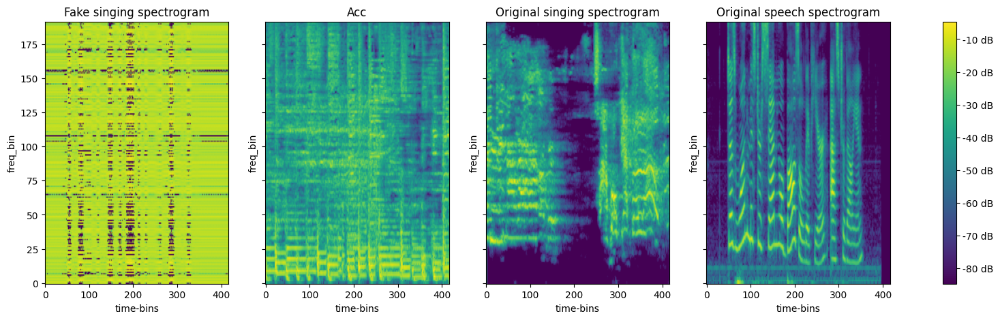

Running batch 101
d_loss: 0.9946235418319702; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9946235418319702
g_loss: 15.916783332824707; built of 'g_loss_whole:2.83542537689209' & 'g_loss_vocal:0.005382442381232977' & 'mae_loss_speech:13.07597541809082'
Running batch 102
d_loss: 0.9945540428161621; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9945540428161621
g_loss: 7.155803680419922; built of 'g_loss_whole:2.561251401901245' & 'g_loss_vocal:0.005452233832329512' & 'mae_loss_speech:4.589100360870361'
Running batch 103
d_loss: 0.9944851994514465; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9944851994514465
g_loss: 7.291351795196533; built of 'g_loss_whole:1.9002877473831177' & 'g_loss_vocal:0.005521280691027641' & 'mae_loss_speech:5.385542869567871'
Running batch 104
d_loss: 0.9945178031921387; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9945178031921387
g_loss: 8.551591873168945; built of 'g_loss_whole:3.259800434112549' & 'g_loss_vocal:0.005488603841513395' & 'mae_loss_speec

100%|██████████| 1000/1000 [00:08<00:00, 114.83it/s, loss=0.0345, spectral_convergence=-3.39]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 110.58it/s, loss=1.89, spectral_convergence=-19]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 115.03it/s, loss=0.0152, spectral_convergence=-16.9]


original speech


100%|██████████| 1000/1000 [00:09<00:00, 110.27it/s, loss=0.037, spectral_convergence=-34.7]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 112.86it/s, loss=1.15, spectral_convergence=-20.7]


display spectrograms


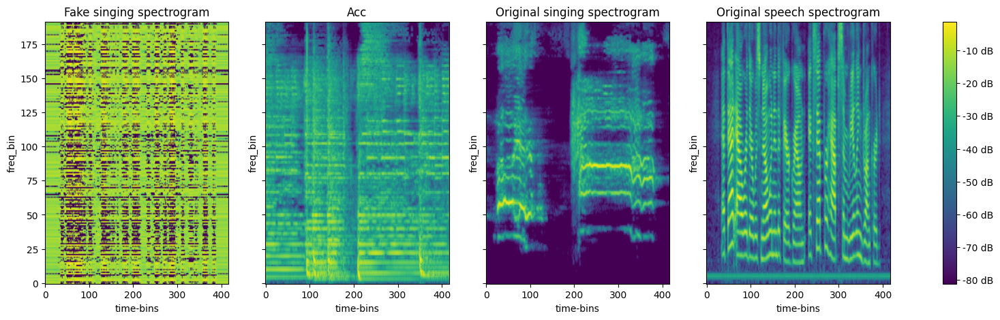

Running batch 201
d_loss: 1.127368450164795; built of 'd_loss_whole:0.13338130712509155' & 'd_loss_vocal':0.9939870834350586
g_loss: 4.3832926750183105; built of 'g_loss_whole:0.8896353840827942' & 'g_loss_vocal:0.0060201724991202354' & 'mae_loss_speech:3.4876370429992676'
Running batch 202
d_loss: 1.473616600036621; built of 'd_loss_whole:0.47970038652420044' & 'd_loss_vocal':0.9939161539077759
g_loss: 4.352267742156982; built of 'g_loss_whole:0.5506617426872253' & 'g_loss_vocal:0.006091087590903044' & 'mae_loss_speech:3.7955148220062256'
Running batch 203
d_loss: 0.9939481019973755; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9939481019973755
g_loss: 7.03166389465332; built of 'g_loss_whole:1.868112564086914' & 'g_loss_vocal:0.006059127859771252' & 'mae_loss_speech:5.157492160797119'
Running batch 204
d_loss: 0.9939961433410645; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9939961433410645
g_loss: 5.976977348327637; built of 'g_loss_whole:1.6347273588180542' & 'g_loss_vocal:0.00

100%|██████████| 1000/1000 [00:08<00:00, 111.82it/s, loss=0.0145, spectral_convergence=-7.89]


song original singing:


100%|██████████| 1000/1000 [00:08<00:00, 111.93it/s, loss=0.0403, spectral_convergence=-30.1]


generated speech:


100%|██████████| 1000/1000 [00:08<00:00, 116.00it/s, loss=0.0149, spectral_convergence=-12.6]


original speech


100%|██████████| 1000/1000 [00:08<00:00, 112.51it/s, loss=0.0697, spectral_convergence=-35.5]


original accompinemant


100%|██████████| 1000/1000 [00:08<00:00, 116.59it/s, loss=0.26, spectral_convergence=-27.5]


display spectrograms


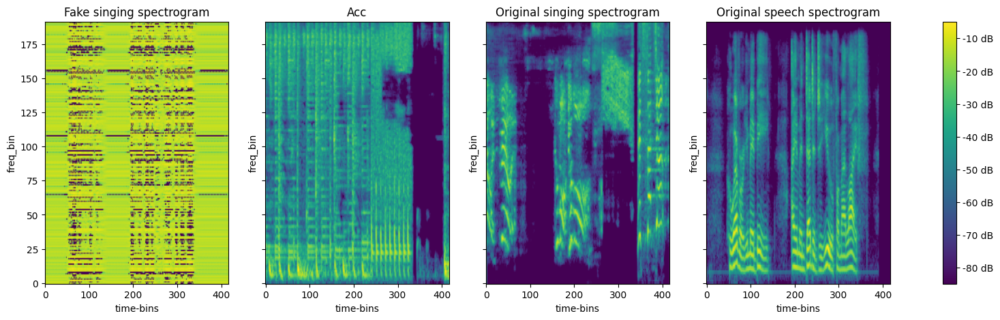

Running batch 301
d_loss: 1.524543046951294; built of 'd_loss_whole:0.5312521457672119' & 'd_loss_vocal':0.9932908415794373
g_loss: 6.473549842834473; built of 'g_loss_whole:0.49257132411003113' & 'g_loss_vocal:0.006717392709106207' & 'mae_loss_speech:5.974261283874512'
Running batch 302
d_loss: 1.2375953197479248; built of 'd_loss_whole:0.24431520700454712' & 'd_loss_vocal':0.9932800531387329
g_loss: 7.58235502243042; built of 'g_loss_whole:2.523829936981201' & 'g_loss_vocal:0.0067282188683748245' & 'mae_loss_speech:5.051796913146973'
Running batch 303
d_loss: 0.9933016896247864; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9933016896247864
g_loss: 6.012755393981934; built of 'g_loss_whole:1.043068528175354' & 'g_loss_vocal:0.006706555839627981' & 'mae_loss_speech:4.962980270385742'
Running batch 304
d_loss: 0.9933167695999146; built of 'd_loss_whole:0.0' & 'd_loss_vocal':0.9933167695999146
g_loss: 5.032925605773926; built of 'g_loss_whole:1.4341177940368652' & 'g_loss_vocal:0.00669

100%|██████████| 1000/1000 [00:08<00:00, 112.23it/s, loss=0.0131, spectral_convergence=-6.98]


song original singing:


100%|██████████| 1000/1000 [00:09<00:00, 109.18it/s, loss=0.8, spectral_convergence=-20.4]


generated speech:


 98%|█████████▊| 980/1000 [00:08<00:00, 108.10it/s, loss=0.00879, spectral_convergence=-14.5]

In [ ]:
opt_gen, opt_disc = optimizers
assert len(songs_batches) == len(speech_batches), "songs_batches and speech_batches must have the same length"
batch_size = len(songs_batches)
for epoch in range(epochs):
    # Iterate over your dataset in batches
    batch_number = 0
    try:
      for batch in dl:
        print(f"Running batch {batch_number}")
        mel_accs, mel_vocs, mel_origs, mel_speeches = batch
        # mel_accs = mel_accs.to('cuda')
        # mel_vocs = mel_vocs.to('cuda')
        # mel_origs = mel_origs.to('cuda')
        # mel_speeches = mel_speeches.to('cuda')


        # Run Generators
        fake_vocs = gen_speech2sing(mel_speeches, mel_accs)
        voc_to_speech = gen_sing2speech(fake_vocs)
        fake_combine = combine_mel_spectrograms(fake_vocs, mel_accs)

        # Run Discriminators
        whole_real_output = discrim_whole(mel_origs)
        whole_fake_output = discrim_whole(fake_combine.detach())
        vocal_real_output = discrim_vocal(mel_vocs)
        vocal_fake_output = discrim_vocal(fake_vocs.detach())

        # Train discriminators
        opt_disc.zero_grad()
        d_loss_whole = d_loss_r(whole_real_output) + d_loss_f(whole_fake_output)
        d_loss_vocal = d_loss_r(vocal_real_output) + d_loss_f(vocal_fake_output)
        d_loss = d_loss_whole + d_loss_vocal
        d_loss.backward()
        opt_disc.step()

        #Train generators
        opt_gen.zero_grad()
        whole_fake_output = discrim_whole(fake_combine.detach())
        vocal_fake_output = discrim_vocal(fake_vocs.detach())
        g_loss_whole = g_loss_f(whole_fake_output)
        g_loss_vocal = g_loss_f(vocal_fake_output)
        mae_loss_speech = mae(voc_to_speech, mel_speeches)
        g_loss = g_loss_whole + g_loss_vocal + mae_loss_speech
        g_loss.backward()
        opt_gen.step()
        print(f"d_loss: {d_loss.item()}; built of 'd_loss_whole:{d_loss_whole.item()}' & 'd_loss_vocal':{d_loss_vocal.item()}")
        print(f"g_loss: {g_loss.item()}; built of 'g_loss_whole:{g_loss_whole.item()}' & 'g_loss_vocal:{g_loss_vocal.item()}' & 'mae_loss_speech:{mae_loss_speech.item()}'")

        if batch_number % 100 == 0:
          try:
            print("generated singing:")
            reconstructed_audio = GRAD(fake_vocs[0].detach(), mel_transform)
            ipd.display(ipd.Audio(reconstructed_audio.numpy(), rate=sr))
            print("song original singing:")
            reconstructed_audio_voc = GRAD(mel_vocs[0].detach(), mel_transform)
            ipd.display(ipd.Audio(reconstructed_audio_voc.numpy(), rate=sr))
            print("generated speech:")
            reconstructed_audio_speech = GRAD(voc_to_speech[0].detach(), mel_transform)
            ipd.display(ipd.Audio(reconstructed_audio_speech.numpy(), rate=sr))
            print("original speech")
            reconstructed_audio_orig = GRAD(mel_speeches[0].detach(), mel_transform)
            ipd.display(ipd.Audio(reconstructed_audio_orig.numpy(), rate=sr))
            print("original accompinemant")
            reconstructed_audio_acc = GRAD(mel_accs[0].detach(), mel_transform)
            ipd.display(ipd.Audio(reconstructed_audio_acc.numpy(), rate=sr))
            print("display spectrograms")
            fig, axs = plt.subplots(1, 4, figsize=(20, 5), sharey=True)  # 1 row, 4 columns

            # Plot spectrograms
            im1 = display_spectrogram(fake_vocs[0].detach().numpy().squeeze(), title='Fake singing spectrogram', ax=axs[0])
            im2 = display_spectrogram(mel_accs[0].detach().numpy().squeeze(), title='Acc', ax=axs[1])
            im3 = display_spectrogram(mel_vocs[0].detach().numpy().squeeze(), title='Original singing spectrogram', ax=axs[2])
            im4 = display_spectrogram(mel_speeches[0].detach().numpy().squeeze(), title='Original speech spectrogram', ax=axs[3])

            # Add a single colorbar
            fig.colorbar(im1, ax=axs, format='%+2.0f dB')  # Use any of the images for colorbar

            plt.show()
            save_models(gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal)
          except Exception as e:
              print(f"Error Saving: {e}")
        batch_number += 1

    except Exception as e:
        print(f"Error during training: {e}")




    # print(f"Models saved for epoch {epoch + 1} in {save_path}")

In [ ]:
def display_spectrogram(spectrogram, title=None, ylabel='freq_bin', aspect='auto', xmax=None):
  fig, axs = plt.subplots(1, 1)
  axs.set_title(title or 'Spectrogram (db)')
  axs.set_ylabel(ylabel)
  axs.set_xlabel('frame')
  im = axs.imshow(librosa.power_to_db(spectrogram), origin='lower', aspect=aspect)
  if xmax:
    axs.set_xlim((0, xmax))
  fig.colorbar(im, ax=axs)
  plt.show(block=False)
  return fig, axs

generated singing:


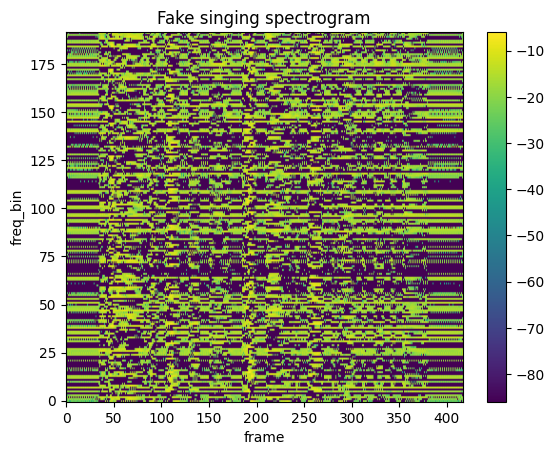

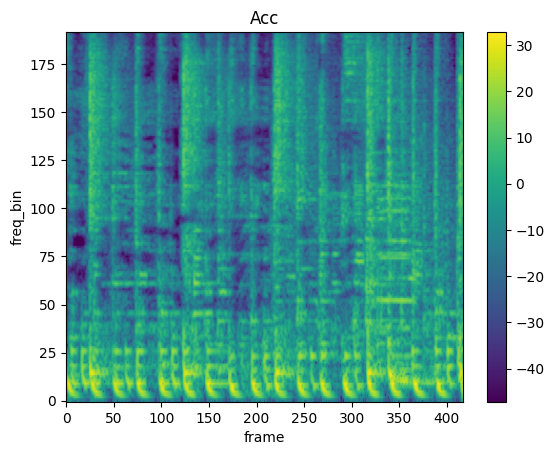

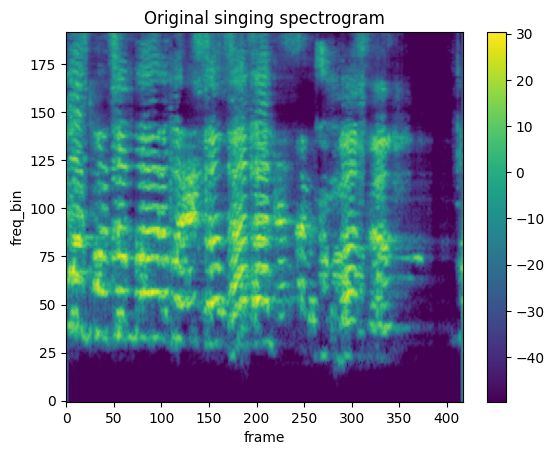

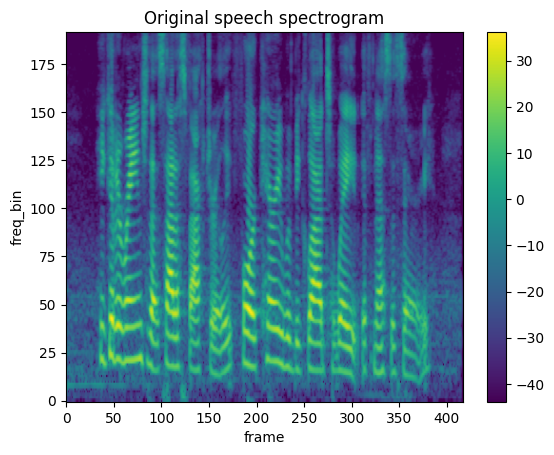

In [ ]:
import matplotlib.pyplot as plt
print("generated singing:")
# reconstructed_audio = GRAD(fake_vocs[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio.numpy(), rate=sr))
# display fake_vocs[0] spectrogram image

# plt.imshow(fake_vocs[0].detach().numpy().squeeze(), aspect='auto', origin='lower', cmap='viridis')
# plt.colorbar(format='%+2.0f dB')
# plt.title('Mel Spectrogram')
# plt.xlabel('Time')
# plt.ylabel('Frequency')
display_spectrogram(fake_vocs[0].detach().numpy().squeeze(), title='Fake singing spectrogram')
display_spectrogram(mel_accs[0].detach().numpy().squeeze(), title='Acc')
display_spectrogram(mel_vocs[0].detach().numpy().squeeze(), title='Original singing spectrogram')
display_spectrogram(mel_speeches[0].detach().numpy().squeeze(), title='Original speech spectrogram')
plt.show()

# print("song original singing:")
# reconstructed_audio_voc = GRAD(mel_vocs[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio_voc.numpy(), rate=sr))
# print("generated speech:")
# reconstructed_audio_speech = GRAD(voc_to_speech[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio_speech.numpy(), rate=sr))
# print("original speech")
# reconstructed_audio_orig = GRAD(mel_speeches[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio_orig.numpy(), rate=sr))
# print("original accompinemant")
# reconstructed_audio_acc = GRAD(mel_accs[0].detach(), mel_transform)
# ipd.display(ipd.Audio(reconstructed_audio_acc.numpy(), rate=sr))
# save_models(gen_speech2sing, gen_sing2speech, discrim_whole, discrim_vocal)